In [1]:
import os
import tools
import numpy as np
import pandas as pd
import scanpy as sc

sc.logging.print_header()

scanpy==1.8.1 anndata==0.7.6 umap==0.5.1 numpy==1.20.2 scipy==1.6.2 pandas==1.2.4 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.1 pynndescent==0.5.2


In [2]:
os.chdir('/lustre/scratch117/cellgen/team297/kt16/COVID_imperial_renal')

In [3]:
# adata = sc.read_h5ad('h5ad/df.fil3_gex_kt.h5ad')
# adata

In [4]:
bdata = sc.read_h5ad('h5ad/df.fil3_gex_bcells_vdj.h5ad')
bdata

AnnData object with n_obs × n_vars = 75683 × 385
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartment

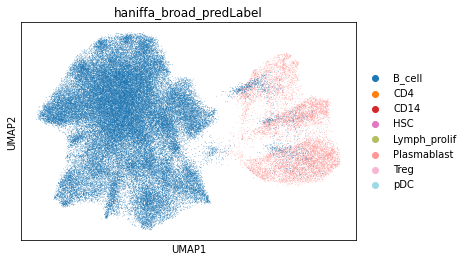

In [5]:
sc.pl.umap(bdata, color = ['haniffa_broad_predLabel'])

In [6]:
# subset to bcells and ASC separately
bcell = bdata[bdata.obs['celltype_B'] == 'B'].raw.to_adata()

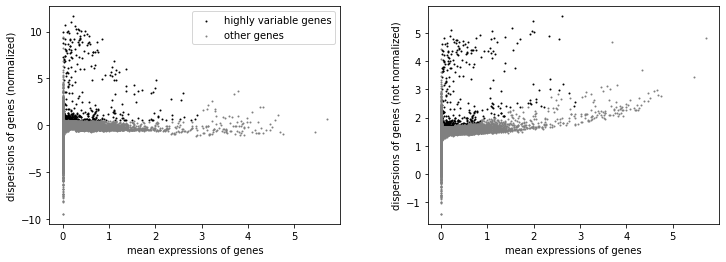

In [7]:
# find highly variable genes
sc.pp.highly_variable_genes(bcell, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bcell)

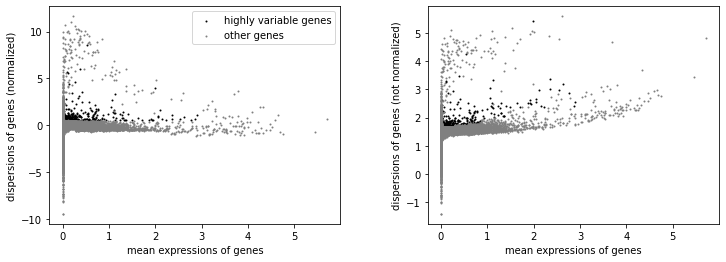

In [8]:
# remove vdj and light chain constant genes from highly variable genes, and also the viral reads
import re
for i in bcell.var.index:
    if re.search('^IG[HKL][VDJC]|VIRAL', i):
        bcell.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(bcell)

In [9]:
# transfer to .raw slot
bcell.raw = bcell

In [10]:
# Filter the rna genes to only those marked as highly-variable
bcell = bcell[:, bcell.var.highly_variable].copy()
bcell

AnnData object with n_obs × n_vars = 66804 × 454
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartment

In [11]:
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(bcell, ['nCount_RNA', 'pct_counts_mt'])
sc.pp.scale(bcell, max_value=10)

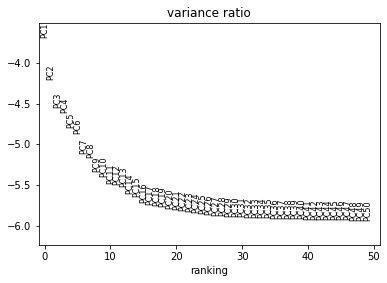

In [12]:
# Run PCA
sc.tl.pca(bcell, svd_solver='arpack')
sc.pl.pca_variance_ratio(bcell, log=True, n_pcs = 50)

In [13]:
# Correcting the PCs with harmonypy
sc.external.pp.harmony_integrate(bcell, 'sample_id', adjusted_basis = 'X_pca')
# Computing the neighborhood graph
sc.pp.neighbors(bcell, n_neighbors=10, n_pcs=30)
# Embedding the neighborhood graph
sc.tl.umap(bcell, min_dist = 0.3)

2021-12-13 16:24:50,242 - harmonypy - INFO - Iteration 1 of 10
2021-12-13 16:25:53,489 - harmonypy - INFO - Iteration 2 of 10
2021-12-13 16:26:54,867 - harmonypy - INFO - Converged after 2 iterations


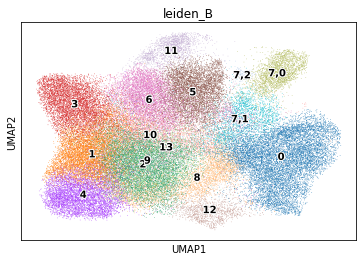

In [14]:
sc.tl.leiden(bcell, key_added = 'leiden_B')
sc.tl.leiden(bcell, key_added = 'leiden_B', restrict_to = ('leiden_B', ['7']), resolution = .3)
sc.pl.umap(bcell, color = 'leiden_B', legend_loc = 'on data', legend_fontoutline = 2)

In [15]:
def summarised_geneset_scores(self, genesets, groupby, figsize=(3, 4), cmap = 'viridis', col_cluster = True, row_cluster = True):
    import numpy as np
    import seaborn as sns
    # calculate average enrichment score
    list1 = list(set(self.obs[groupby]))
    subset = self.obs[[groupby] + [str(s) for s in genesets]]
    output = pd.DataFrame()
    for x in list1:
        subsetX = subset[subset[groupby] == x]
        outdict = {}
        for k in [str(s) for s in genesets]:
            out = {k:np.mean(subsetX[k])}
            outdict.update(out)
        output = output.append(outdict, ignore_index=True)
    output.index = list1
    output = output[[str(s) for s in genesets]]
    g = sns.clustermap(output.transpose(), standard_scale = 0, cmap=cmap, figsize=figsize, col_cluster = col_cluster, row_cluster = row_cluster)
    sc.pl.umap(self, color = [str(s) for s in genesets], size = 10, ncols = 2)
    print(g)

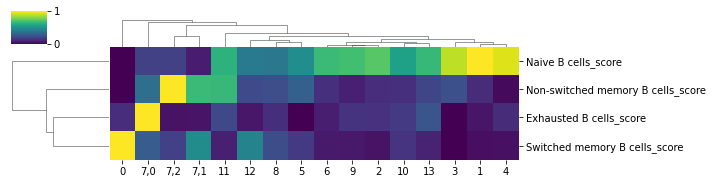

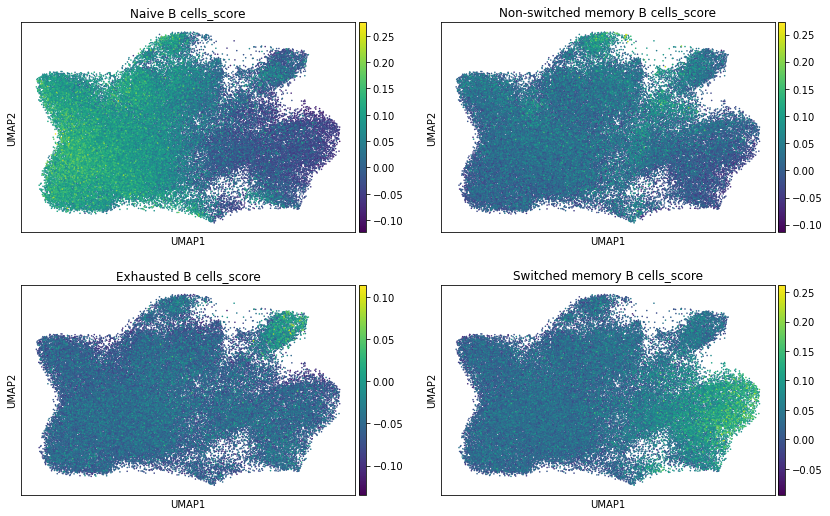

In [16]:
summarised_geneset_scores(bcell, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B',
                          (10,2.5))

In [17]:
# read in the adt file
adt = sc.read_h5ad('h5ad/df.fil3_adt.h5ad')
badt = adt[adt.obs_names.isin(bcell.obs_names)].copy()
badt.obsm = bcell.obsm.copy()
badt.obs = bcell.obs.copy()
badt

AnnData object with n_obs × n_vars = 66804 × 137
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartment

In [18]:
sorted([l for l in badt.var_names])

['AB-ADGRG1',
 'AB-ANPEP',
 'AB-B3GAT1',
 'AB-BTLA',
 'AB-C5AR1',
 'AB-CCR4',
 'AB-CCR5',
 'AB-CCR6',
 'AB-CD101',
 'AB-CD14',
 'AB-CD163',
 'AB-CD19',
 'AB-CD1C',
 'AB-CD1D',
 'AB-CD2',
 'AB-CD22',
 'AB-CD226',
 'AB-CD24',
 'AB-CD244',
 'AB-CD27',
 'AB-CD274',
 'AB-CD28',
 'AB-CD33',
 'AB-CD36',
 'AB-CD38',
 'AB-CD3D',
 'AB-CD4',
 'AB-CD40',
 'AB-CD40LG',
 'AB-CD44',
 'AB-CD45',
 'AB-CD45RA',
 'AB-CD45RO',
 'AB-CD47',
 'AB-CD48',
 'AB-CD5',
 'AB-CD52',
 'AB-CD58',
 'AB-CD69',
 'AB-CD7',
 'AB-CD79B',
 'AB-CD81',
 'AB-CD82',
 'AB-CD83',
 'AB-CD86',
 'AB-CD8A',
 'AB-CD99',
 'AB-CLEC12A',
 'AB-CLEC4C',
 'AB-CR1',
 'AB-CR2',
 'AB-CTLA4',
 'AB-CX3CR1',
 'AB-CXCR3',
 'AB-CXCR5',
 'AB-DPP4',
 'AB-ENG',
 'AB-ENTPD1',
 'AB-FAS',
 'AB-FCER1A',
 'AB-FCER2',
 'AB-FCGR1A',
 'AB-FCGR2A',
 'AB-FCGR3A',
 'AB-GGT1',
 'AB-GP1BB',
 'AB-HLA-A',
 'AB-HLA-DRA',
 'AB-HLA-E',
 'AB-ICAM1',
 'AB-ICOS',
 'AB-IFNGR1',
 'AB-IGHD',
 'AB-IGHM',
 'AB-IGKC',
 'AB-IL2RA',
 'AB-IL2RB',
 'AB-IL3RA',
 'AB-IL4R',
 'AB-IL7R

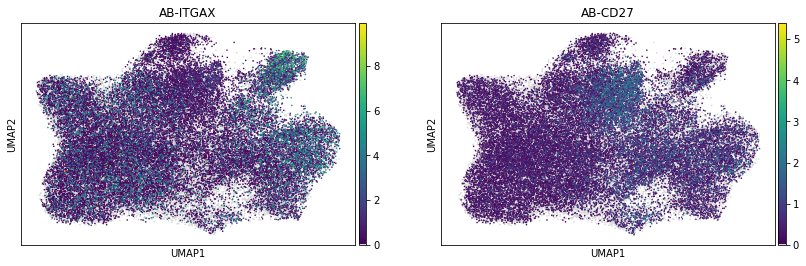

In [19]:
sc.pl.umap(badt, color = ['AB-ITGAX', 'AB-CD27'], color_map = tools.cmp(), size = 10)

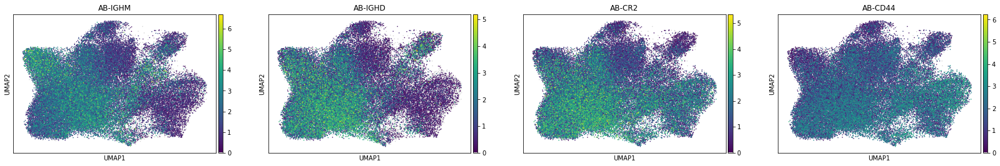

In [20]:
sc.pl.umap(badt, color = ['AB-IGHM', 'AB-IGHD', 'AB-CR2', 'AB-CD44'], color_map = tools.cmp(), size = 10)

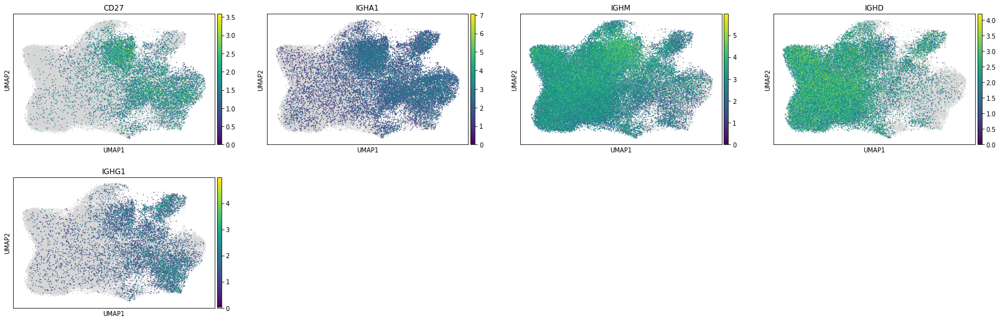

In [21]:
sc.pl.umap(bcell, color = ['CD27', 'IGHA1', 'IGHM','IGHD','IGHG1'], color_map = tools.cmp(), size = 10)

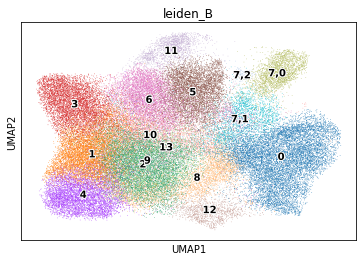

In [22]:
sc.pl.umap(bcell, color = 'leiden_B', legend_loc = 'on data', legend_fontoutline = 2)

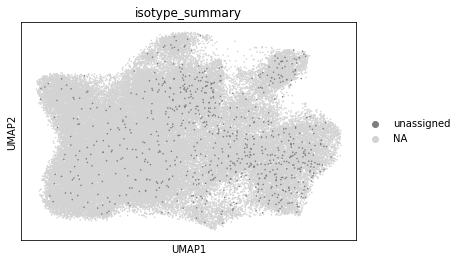

In [23]:
sc.pl.umap(bcell, color = 'isotype_summary', size = 10, groups = 'unassigned')

In [24]:
bcell.obs['has_contig'].value_counts()

True         59264
No_contig     7540
Name: has_contig, dtype: int64

In [25]:
ascs.obs['has_contig'].value_counts()

True         6721
No_contig    2158
Name: has_contig, dtype: int64

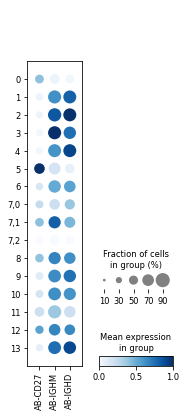

In [26]:
ax = sc.pl.dotplot(badt, ['AB-CD27', 'AB-IGHM','AB-IGHD'], groupby = 'leiden_B', color_map = 'Blues', standard_scale = 'var', return_fig = True)
ax.style(dot_edge_lw = 0, cmap = 'Blues')
ax.show()

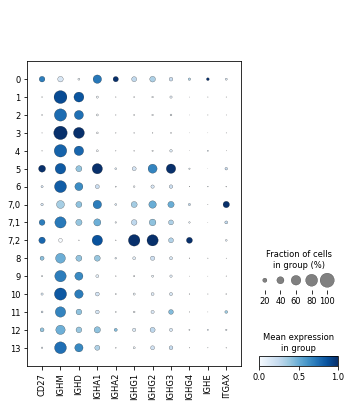

In [27]:
sc.pl.dotplot(bcell, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE','ITGAX'], groupby = 'leiden_B', color_map = 'Blues', standard_scale = 'var')

... storing 'celltype_B' as categorical


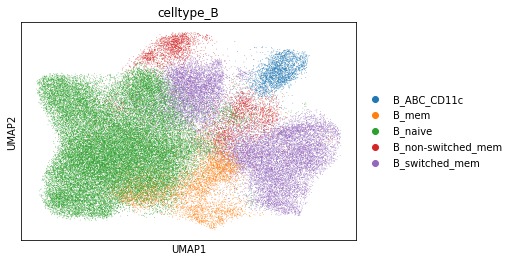

In [28]:
b_dict = {'0':'B_switched_mem',
'1':'B_naive',
'2':'B_naive',
'3':'B_naive',
'4':'B_naive',
'5':'B_switched_mem',
'6':'B_naive',
'7,0':'B_ABC_CD11c',
'7,1':'B_non-switched_mem',
'7,2':'B_switched_mem',
'8':'B_mem',
'9':'B_naive',
'10':'B_naive',
'11':'B_non-switched_mem',
'12':'B_mem',
'13':'B_naive',}
bcell.obs['celltype_B'] = [b_dict[x] for x in bcell.obs['leiden_B']]
sc.pl.umap(bcell, color = 'celltype_B')

### memory

In [29]:
bmem = bcell[bcell.obs['celltype_B'].isin(['B_mem', 'B_non-switched_mem', 'B_switched_mem'])].raw.to_adata()

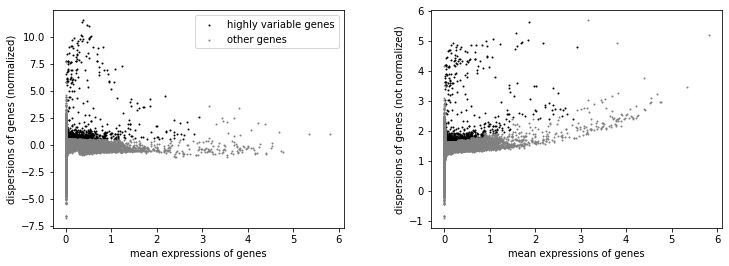

In [30]:
# find highly variable genes
sc.pp.highly_variable_genes(bmem, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bmem)

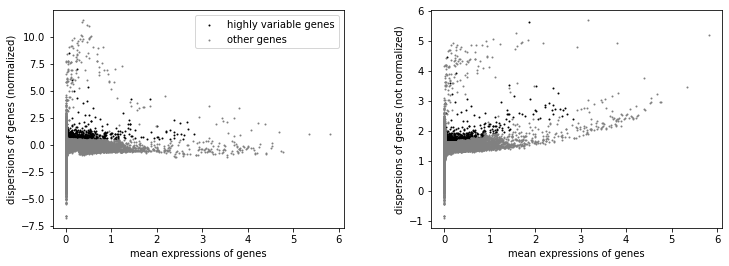

In [31]:
# remove vdj and light chain constant genes from highly variable genes, and also the viral reads
import re
for i in bmem.var.index:
    if re.search('^IG[HKL][VDJC]|VIRAL', i):
        bmem.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(bmem)

In [32]:
# transfer to .raw slot
bmem.raw = bmem

In [33]:
# Filter the rna genes to only those marked as highly-variable
bmem = bmem[:, bmem.var.highly_variable].copy()
bmem

AnnData object with n_obs × n_vars = 25826 × 1075
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartmen

In [34]:
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(bmem, ['nCount_RNA', 'pct_counts_mt'])
sc.pp.scale(bmem, max_value=10)

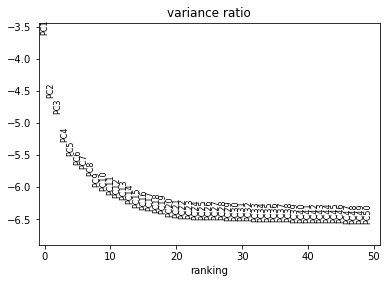

In [35]:
# Run PCA
sc.tl.pca(bmem, svd_solver='arpack')
sc.pl.pca_variance_ratio(bmem, log=True, n_pcs = 50)

In [36]:
# Correcting the PCs with harmonypy
sc.external.pp.harmony_integrate(bmem, 'sample_id', adjusted_basis = 'X_pca')
# Computing the neighborhood graph
sc.pp.neighbors(bmem, n_neighbors=10, n_pcs=30)
# Embedding the neighborhood graph
sc.tl.umap(bmem, min_dist = 0.3)

2021-12-13 16:29:53,022 - harmonypy - INFO - Iteration 1 of 10
2021-12-13 16:30:13,678 - harmonypy - INFO - Iteration 2 of 10
2021-12-13 16:30:35,883 - harmonypy - INFO - Converged after 2 iterations


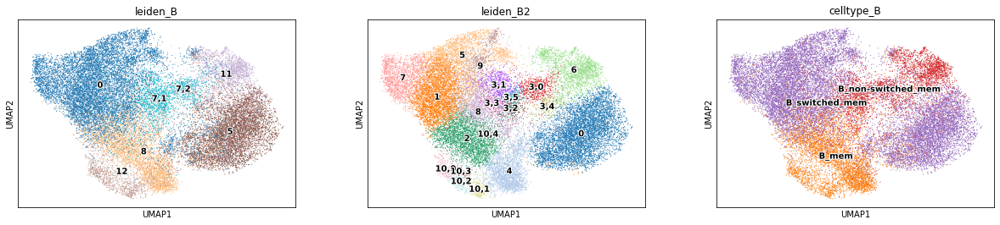

In [37]:
sc.tl.leiden(bmem, key_added = 'leiden_B2')
sc.tl.leiden(bmem, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['3']), resolution = .5)
sc.tl.leiden(bmem, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['10']), resolution = .5)
sc.pl.umap(bmem, color = ['leiden_B','leiden_B2', 'celltype_B'], legend_loc = 'on data', legend_fontoutline = 2)

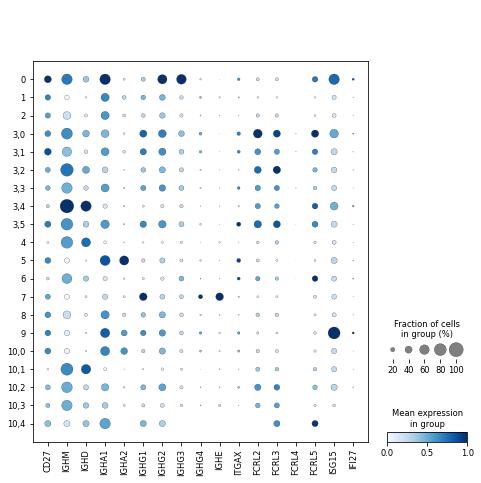

In [38]:
sc.pl.dotplot(bmem, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE','ITGAX', 'FCRL2','FCRL3','FCRL4','FCRL5', 'ISG15', 'IFI27'], groupby = 'leiden_B2', color_map = 'Blues', standard_scale = 'var')

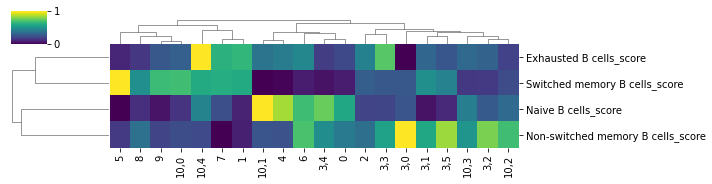

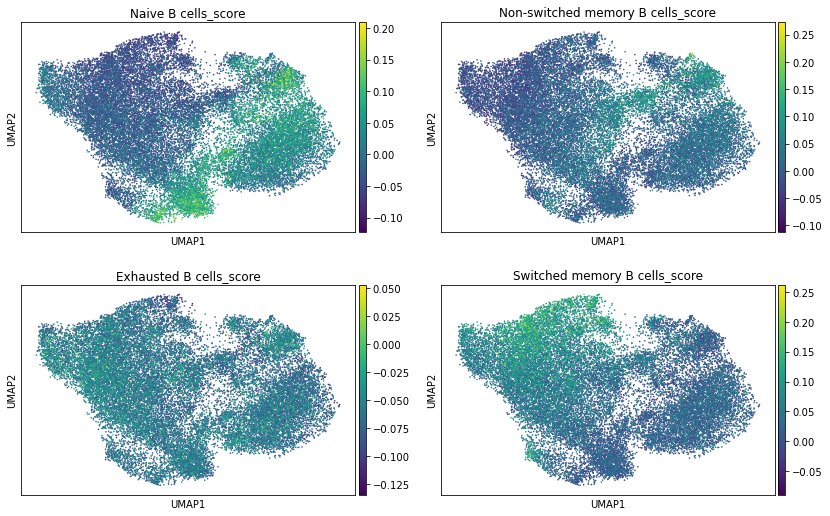

In [39]:
summarised_geneset_scores(bmem, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B2',
                          (10,2.5))

... storing 'celltype_B' as categorical


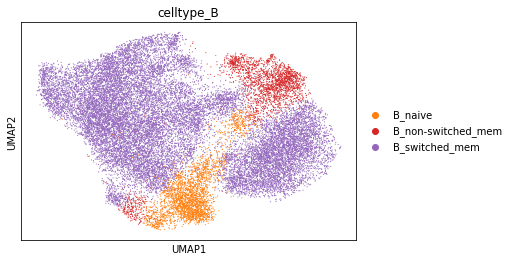

In [40]:
b_dict = {'0':'B_switched_mem',
'1':'B_switched_mem',
'2':'B_switched_mem',
'3,0':'B_switched_mem',
'3,1':'B_switched_mem',
'3,2':'B_switched_mem',
'3,3':'B_switched_mem',
'3,4':'B_naive',
'3,5':'B_switched_mem',
'4':'B_naive',
'5':'B_switched_mem',
'6':'B_non-switched_mem',
'7':'B_switched_mem',
'8':'B_switched_mem',
'9':'B_switched_mem',
'10,0':'B_switched_mem',
'10,1':'B_naive',
'10,2':'B_non-switched_mem',
'10,3':'B_non-switched_mem',
'10,4':'B_switched_mem',}
bmem.obs['celltype_B'] = [b_dict[x] for x in bmem.obs['leiden_B2']]
sc.pl.umap(bmem, color = 'celltype_B')

... storing 'celltype_B' as categorical


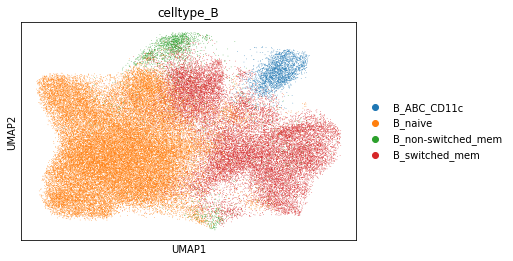

In [41]:
bcell.obs['celltype_B'] = bcell.obs['celltype_B'].astype('object')
bcell.obs['celltype_B'].update(pd.Series(bmem.obs['celltype_B']))
sc.pl.umap(bcell, color = 'celltype_B')

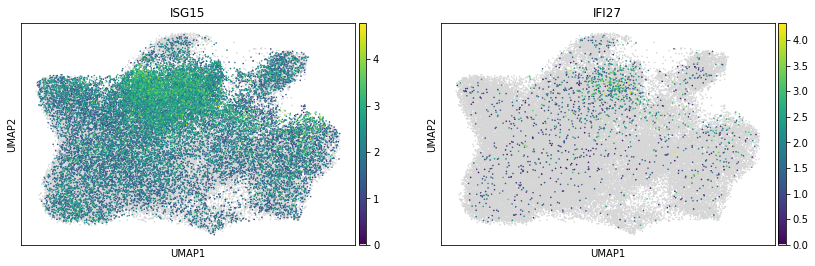

In [42]:
sc.pl.umap(bcell, color = ['ISG15', 'IFI27'], color_map = tools.cmp(), size = 10)

### naive

In [43]:
bnav = bcell[bcell.obs['celltype_B'].isin(['B_naive'])].raw.to_adata()

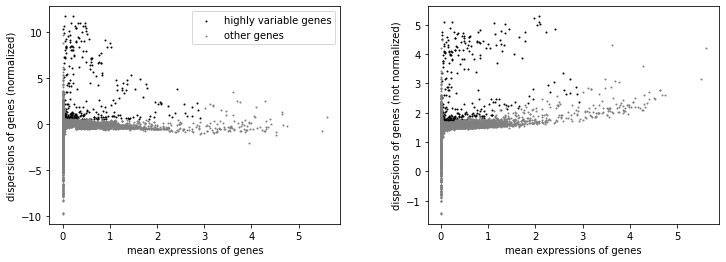

In [44]:
# find highly variable genes
sc.pp.highly_variable_genes(bnav, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bnav)

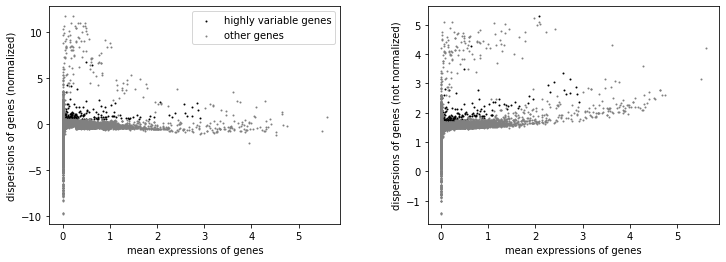

In [45]:
# remove vdj and light chain constant genes from highly variable genes, and also the viral reads
import re
for i in bnav.var.index:
    if re.search('^IG[HKL][VDJC]|VIRAL', i):
        bnav.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(bnav)

In [46]:
# transfer to .raw slot
bnav.raw = bnav

In [47]:
# Filter the rna genes to only those marked as highly-variable
bnav = bnav[:, bnav.var.highly_variable].copy()
bnav

AnnData object with n_obs × n_vars = 41313 × 330
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartment

In [48]:
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(bnav, ['nCount_RNA', 'pct_counts_mt'])
sc.pp.scale(bnav, max_value=10)

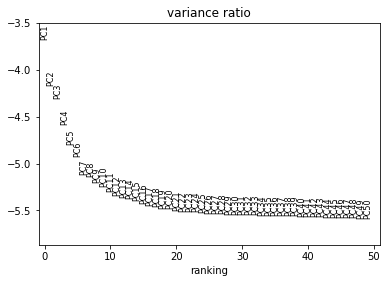

In [49]:
# Run PCA
sc.tl.pca(bnav, svd_solver='arpack')
sc.pl.pca_variance_ratio(bnav, log=True, n_pcs = 50)

In [50]:
# Correcting the PCs with harmonypy
sc.external.pp.harmony_integrate(bnav, 'sample_id', adjusted_basis = 'X_pca', max_iter_harmony =30)
# Computing the neighborhood graph
sc.pp.neighbors(bnav, n_neighbors=10, n_pcs=20)
# Embedding the neighborhood graph
sc.tl.umap(bnav, min_dist = 0.3)

2021-12-13 16:31:29,426 - harmonypy - INFO - Iteration 1 of 30
2021-12-13 16:32:06,833 - harmonypy - INFO - Iteration 2 of 30
2021-12-13 16:32:43,152 - harmonypy - INFO - Iteration 3 of 30
2021-12-13 16:33:19,869 - harmonypy - INFO - Iteration 4 of 30
2021-12-13 16:33:47,610 - harmonypy - INFO - Iteration 5 of 30
2021-12-13 16:34:13,705 - harmonypy - INFO - Iteration 6 of 30
2021-12-13 16:34:38,984 - harmonypy - INFO - Iteration 7 of 30
2021-12-13 16:35:03,336 - harmonypy - INFO - Iteration 8 of 30
2021-12-13 16:35:28,863 - harmonypy - INFO - Iteration 9 of 30
2021-12-13 16:36:01,198 - harmonypy - INFO - Iteration 10 of 30
2021-12-13 16:36:26,050 - harmonypy - INFO - Iteration 11 of 30
2021-12-13 16:36:51,584 - harmonypy - INFO - Iteration 12 of 30
2021-12-13 16:37:16,920 - harmonypy - INFO - Iteration 13 of 30
2021-12-13 16:37:41,645 - harmonypy - INFO - Iteration 14 of 30
2021-12-13 16:38:06,695 - harmonypy - INFO - Iteration 15 of 30
2021-12-13 16:38:31,879 - harmonypy - INFO - Conv

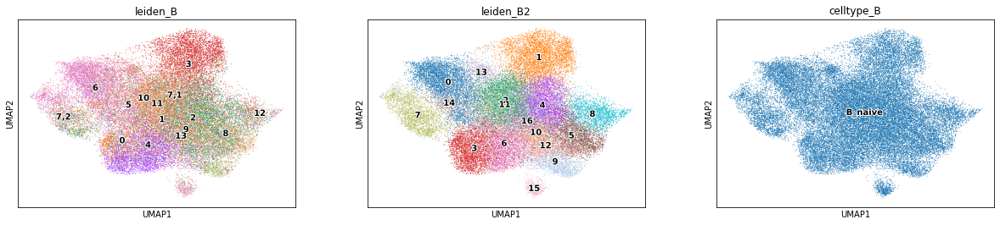

In [51]:
sc.tl.leiden(bnav, key_added = 'leiden_B2')
# sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['3']), resolution = .5)
# sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['10']), resolution = .5)
sc.pl.umap(bnav, color = ['leiden_B','leiden_B2', 'celltype_B'], legend_loc = 'on data', legend_fontoutline = 2)

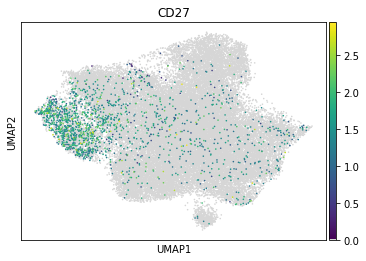

In [54]:
sc.pl.umap(bnav, color = ['CD27'], color_map = tools.cmp(), size = 10)

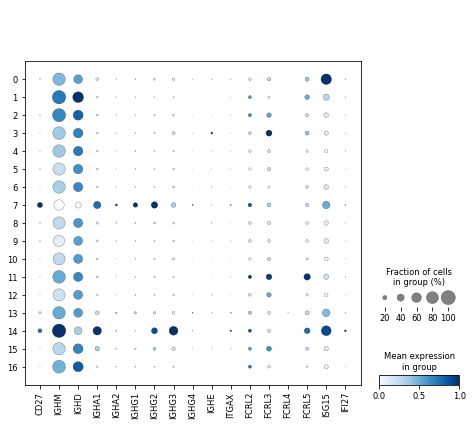

In [52]:
sc.pl.dotplot(bnav, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE','ITGAX', 'FCRL2','FCRL3','FCRL4','FCRL5', 'ISG15', 'IFI27'], groupby = 'leiden_B2', color_map = 'Blues', standard_scale = 'var')

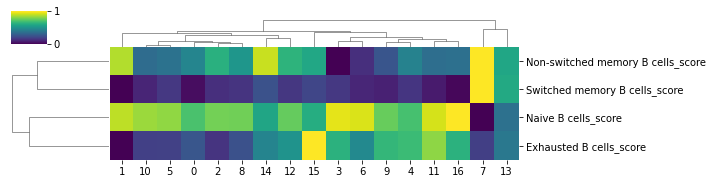

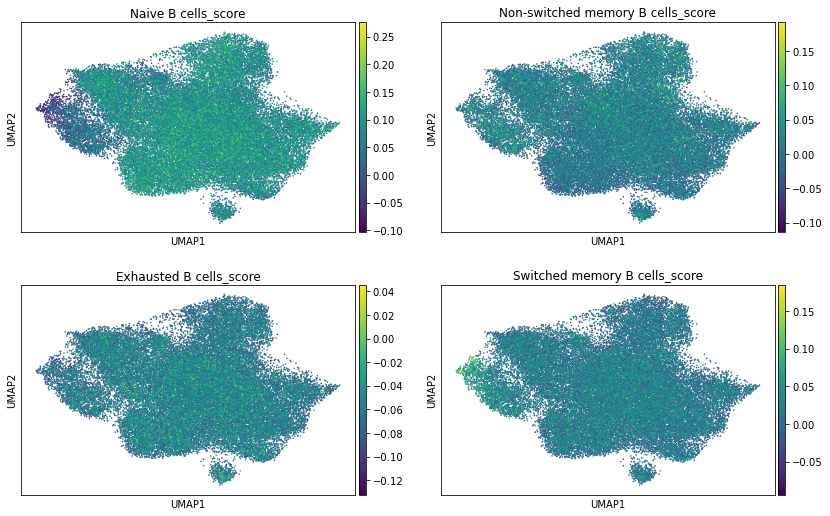

In [56]:
summarised_geneset_scores(bnav, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B2',
                          (10,2.5))

... storing 'celltype_B' as categorical


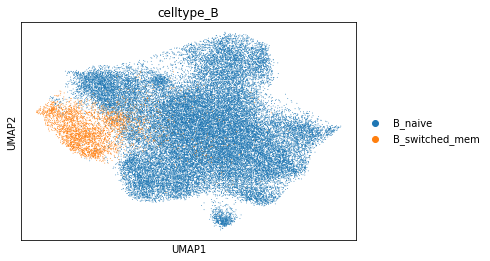

In [57]:
b_dict = {'0':'B_naive',
'1':'B_naive',
'2':'B_naive',
'3':'B_naive',
'4':'B_naive',
'5':'B_naive',
'6':'B_naive',
'7':'B_switched_mem',
'8':'B_naive',
'9':'B_naive',
'10':'B_naive',
'11':'B_naive',
'12':'B_naive',
'13':'B_naive',
'14':'B_switched_mem',
'15':'B_naive',
'16':'B_naive',}
bnav.obs['celltype_B'] = [b_dict[x] for x in bnav.obs['leiden_B2']]
sc.pl.umap(bnav, color = 'celltype_B')

... storing 'celltype_B' as categorical


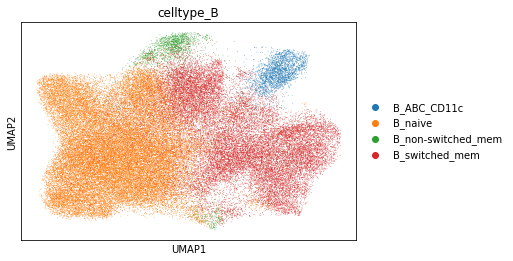

In [58]:
bcell.obs['celltype_B'] = bcell.obs['celltype_B'].astype('object')
bcell.obs['celltype_B'].update(pd.Series(bnav.obs['celltype_B']))
sc.pl.umap(bcell, color = 'celltype_B')

### memory
Re-check memory

In [59]:
bmem = bcell[bcell.obs['celltype_B'].isin(['B_non-switched_mem', 'B_switched_mem'])].raw.to_adata()

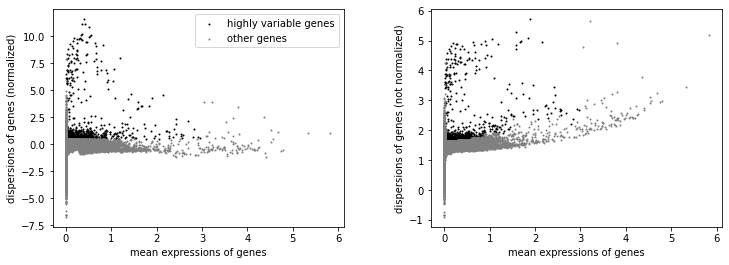

In [60]:
# find highly variable genes
sc.pp.highly_variable_genes(bmem, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bmem)

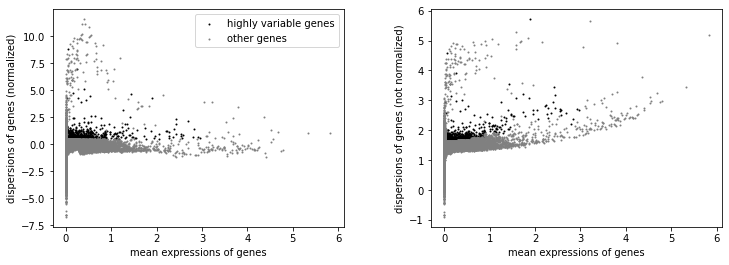

In [61]:
# remove vdj and light chain constant genes from highly variable genes, and also the viral reads
import re
for i in bmem.var.index:
    if re.search('^IG[HKL][VDJC]|VIRAL', i):
        bmem.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(bmem)

In [62]:
# transfer to .raw slot
bmem.raw = bmem

In [63]:
# Filter the rna genes to only those marked as highly-variable
bmem = bmem[:, bmem.var.highly_variable].copy()
bmem

AnnData object with n_obs × n_vars = 26539 × 1063
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartmen

In [64]:
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(bmem, ['nCount_RNA', 'pct_counts_mt'])
sc.pp.scale(bmem, max_value=10)

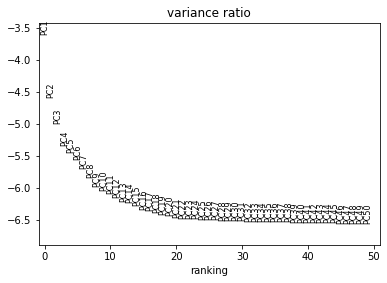

In [65]:
# Run PCA
sc.tl.pca(bmem, svd_solver='arpack')
sc.pl.pca_variance_ratio(bmem, log=True, n_pcs = 50)

In [85]:
# Correcting the PCs with harmonypy
# sc.external.pp.harmony_integrate(bmem, 'sample_id', adjusted_basis = 'X_pca', max_iter_harmony =30)
# Computing the neighborhood graph
sc.pp.neighbors(bmem, n_neighbors=10, n_pcs=20)
# Embedding the neighborhood graph
sc.tl.umap(bmem, min_dist = 0.3)

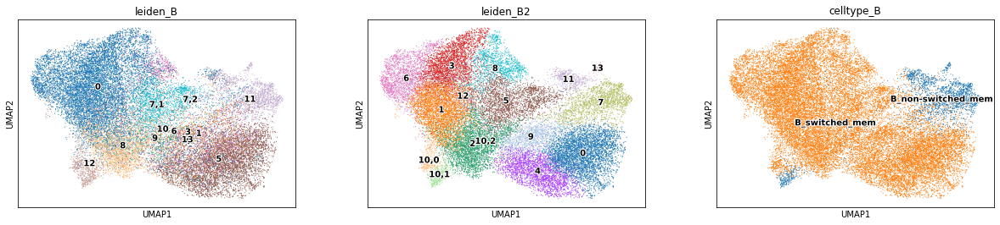

In [103]:
sc.tl.leiden(bmem, key_added = 'leiden_B2')
# sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['3']), resolution = .5)
sc.tl.leiden(bmem, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['10']), resolution = .3)
sc.pl.umap(bmem, color = ['leiden_B','leiden_B2', 'celltype_B'], legend_loc = 'on data', legend_fontoutline = 2)

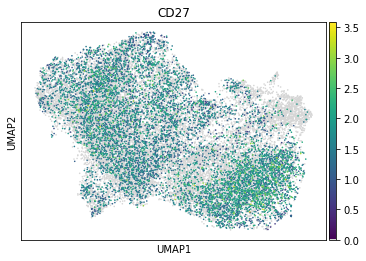

In [107]:
sc.pl.umap(bmem, color = ['CD27'], color_map = tools.cmp(), size = 10)

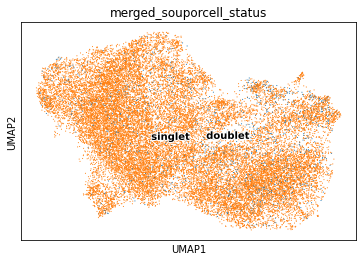

In [104]:
sc.pl.umap(bmem, color = ['merged_souporcell_status'], legend_loc = 'on data', legend_fontoutline = 2)

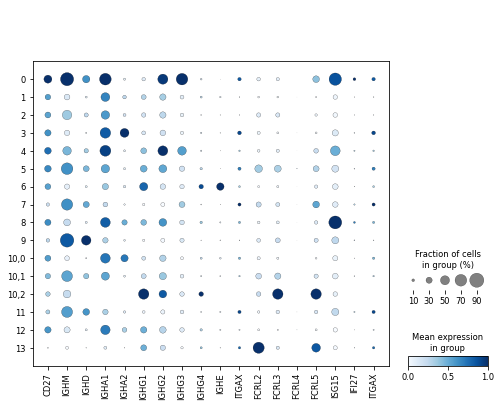

In [105]:
sc.pl.dotplot(bmem, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE','ITGAX', 'FCRL2','FCRL3','FCRL4','FCRL5', 'ISG15', 'IFI27', 'ITGAX'], groupby = 'leiden_B2', color_map = 'Blues', standard_scale = 'var')

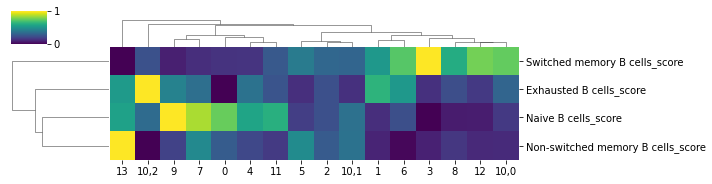

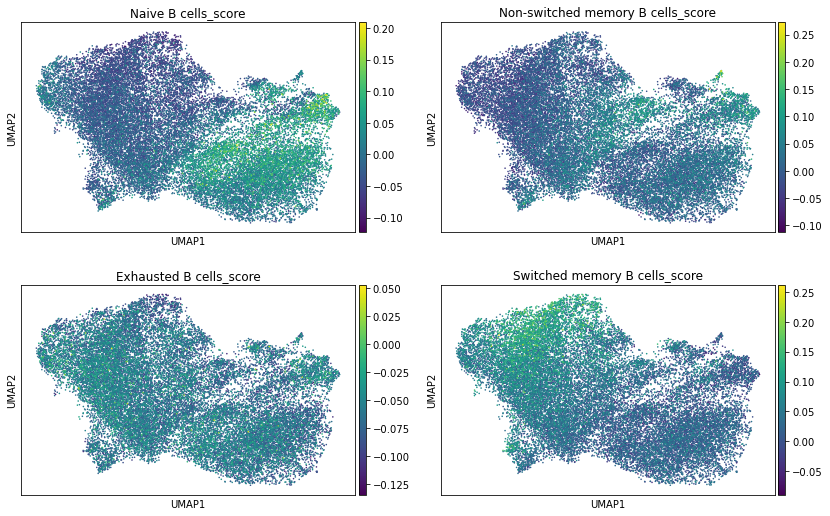

In [108]:
summarised_geneset_scores(bmem, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B2',
                          (10,2.5))

... storing 'celltype_B' as categorical


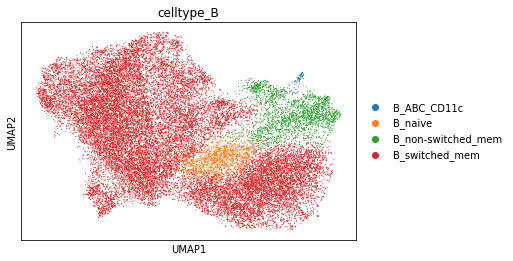

In [109]:
b_dict = {'0':'B_switched_mem',
'1':'B_switched_mem',
'2':'B_switched_mem',
'3':'B_switched_mem',
'4':'B_switched_mem',
'5':'B_switched_mem',
'6':'B_switched_mem',
'7':'B_non-switched_mem',
'8':'B_switched_mem',
'9':'B_naive',
'10,0':'B_switched_mem',
'10,1':'B_switched_mem',
'10,2':'B_switched_mem',
'11':'B_non-switched_mem',
'12':'B_switched_mem',
'13':'B_ABC_CD11c',}
bmem.obs['celltype_B'] = [b_dict[x] for x in bmem.obs['leiden_B2']]
sc.pl.umap(bmem, color = 'celltype_B')

... storing 'celltype_B' as categorical


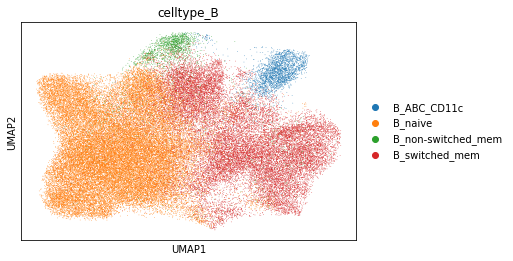

In [111]:
bcell.obs['celltype_B'] = bcell.obs['celltype_B'].astype('object')
bcell.obs['celltype_B'].update(pd.Series(bmem.obs['celltype_B']))
sc.pl.umap(bcell, color = 'celltype_B')

### repeat naive clean up

In [112]:
bnav = bcell[bcell.obs['celltype_B'].isin(['B_naive'])].raw.to_adata()

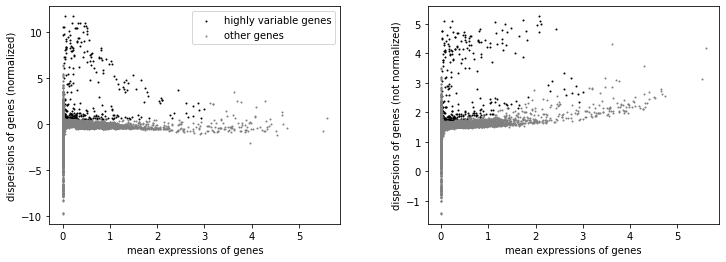

In [113]:
# find highly variable genes
sc.pp.highly_variable_genes(bnav, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bnav)

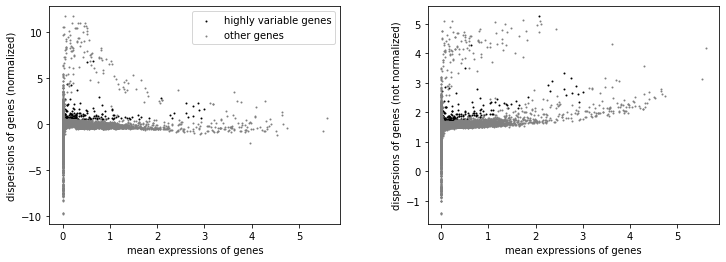

In [114]:
# remove vdj and light chain constant genes from highly variable genes, and also the viral reads
import re
for i in bnav.var.index:
    if re.search('^IG[HKL][VDJC]|VIRAL', i):
        bnav.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(bnav)

In [115]:
# transfer to .raw slot
bnav.raw = bnav

In [116]:
# Filter the rna genes to only those marked as highly-variable
bnav = bnav[:, bnav.var.highly_variable].copy()
bnav

AnnData object with n_obs × n_vars = 39020 × 305
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartment

In [117]:
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(bnav, ['nCount_RNA', 'pct_counts_mt'])
sc.pp.scale(bnav, max_value=10)

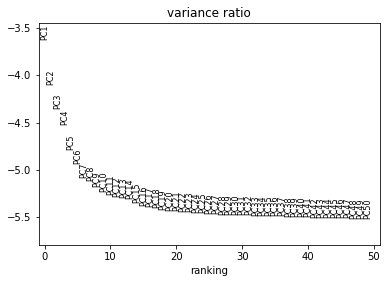

In [118]:
# Run PCA
sc.tl.pca(bnav, svd_solver='arpack')
sc.pl.pca_variance_ratio(bnav, log=True, n_pcs = 50)

In [119]:
# Correcting the PCs with harmonypy
sc.external.pp.harmony_integrate(bnav, 'sample_id', adjusted_basis = 'X_pca', max_iter_harmony =30)
# Computing the neighborhood graph
sc.pp.neighbors(bnav, n_neighbors=10, n_pcs=20)
# Embedding the neighborhood graph
sc.tl.umap(bnav, min_dist = 0.3)

2021-12-13 17:21:42,527 - harmonypy - INFO - Iteration 1 of 30
2021-12-13 17:22:17,101 - harmonypy - INFO - Iteration 2 of 30
2021-12-13 17:22:49,647 - harmonypy - INFO - Iteration 3 of 30
2021-12-13 17:23:23,459 - harmonypy - INFO - Iteration 4 of 30
2021-12-13 17:23:46,973 - harmonypy - INFO - Iteration 5 of 30
2021-12-13 17:24:09,377 - harmonypy - INFO - Iteration 6 of 30
2021-12-13 17:24:33,033 - harmonypy - INFO - Iteration 7 of 30
2021-12-13 17:24:56,261 - harmonypy - INFO - Iteration 8 of 30
2021-12-13 17:25:19,693 - harmonypy - INFO - Iteration 9 of 30
2021-12-13 17:25:42,103 - harmonypy - INFO - Iteration 10 of 30
2021-12-13 17:26:05,922 - harmonypy - INFO - Iteration 11 of 30
2021-12-13 17:26:28,469 - harmonypy - INFO - Iteration 12 of 30
2021-12-13 17:26:51,942 - harmonypy - INFO - Iteration 13 of 30
2021-12-13 17:27:15,690 - harmonypy - INFO - Iteration 14 of 30
2021-12-13 17:27:39,224 - harmonypy - INFO - Iteration 15 of 30
2021-12-13 17:28:01,643 - harmonypy - INFO - Iter

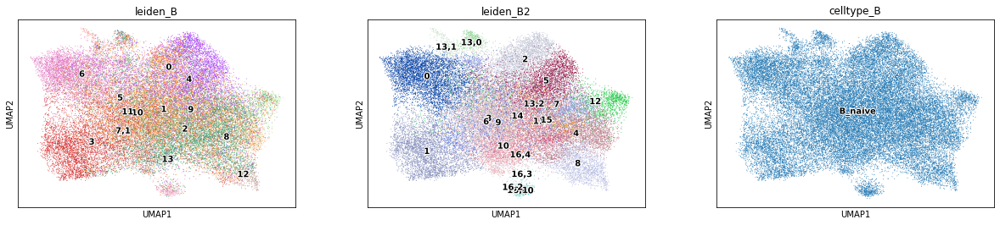

In [130]:
sc.tl.leiden(bnav, key_added = 'leiden_B2')
sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['13']), resolution = .5)
sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['16']), resolution = .5)
sc.pl.umap(bnav, color = ['leiden_B','leiden_B2', 'celltype_B'], legend_loc = 'on data', legend_fontoutline = 2)

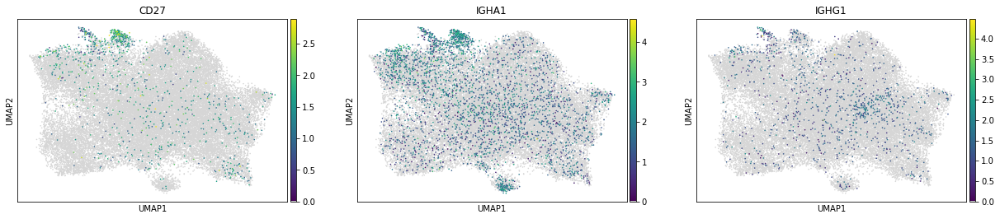

In [126]:
sc.pl.umap(bnav, color = ['CD27', 'IGHA1', 'IGHG1'], color_map = tools.cmp(), size = 10)

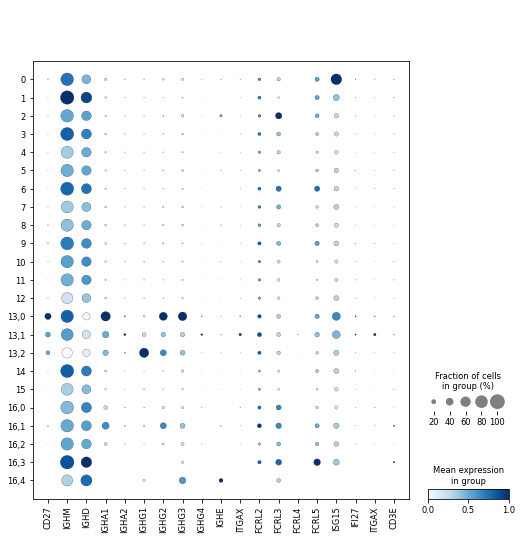

In [135]:
sc.pl.dotplot(bnav, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE','ITGAX', 'FCRL2','FCRL3','FCRL4','FCRL5', 'ISG15', 'IFI27', 'ITGAX', 'CD3E'], groupby = 'leiden_B2', color_map = 'Blues', standard_scale = 'var')

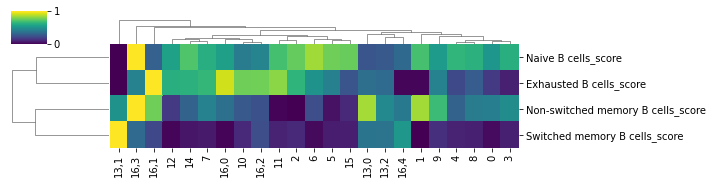

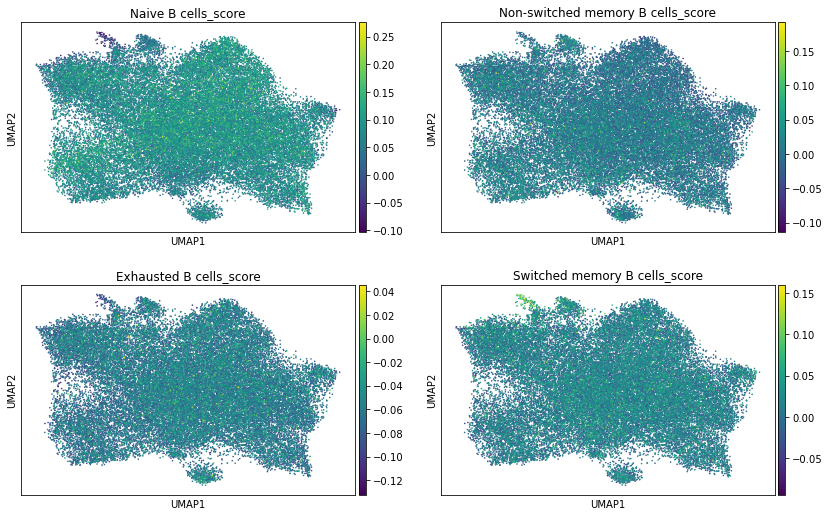

In [132]:
summarised_geneset_scores(bnav, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B2',
                          (10,2.5))

... storing 'celltype_B' as categorical


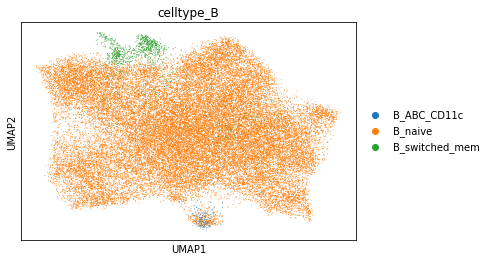

In [137]:
b_dict = {'0':'B_naive',
'1':'B_naive',
'2':'B_naive',
'3':'B_naive',
'4':'B_naive',
'5':'B_naive',
'6':'B_naive',
'7':'B_naive',
'8':'B_naive',
'9':'B_naive',
'10':'B_naive',
'11':'B_naive',
'12':'B_naive',
'13,0':'B_switched_mem',
'13,1':'B_switched_mem',
'13,2':'B_switched_mem',
'14':'B_naive',
'15':'B_naive',
'16,0':'B_naive',
'16,1':'B_ABC_CD11c',
'16,2':'B_naive',
'16,3':'B_naive',
'16,4':'B_ABC_CD11c',}
bnav.obs['celltype_B'] = [b_dict[x] for x in bnav.obs['leiden_B2']]
sc.pl.umap(bnav, color = 'celltype_B')

... storing 'celltype_B' as categorical


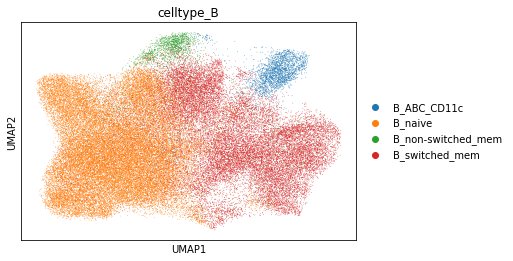

In [138]:
bcell.obs['celltype_B'] = bcell.obs['celltype_B'].astype('object')
bcell.obs['celltype_B'].update(pd.Series(bnav.obs['celltype_B']))
sc.pl.umap(bcell, color = 'celltype_B')

### memory
Re-check memory

In [139]:
bmem = bcell[bcell.obs['celltype_B'].isin(['B_non-switched_mem', 'B_switched_mem'])].raw.to_adata()

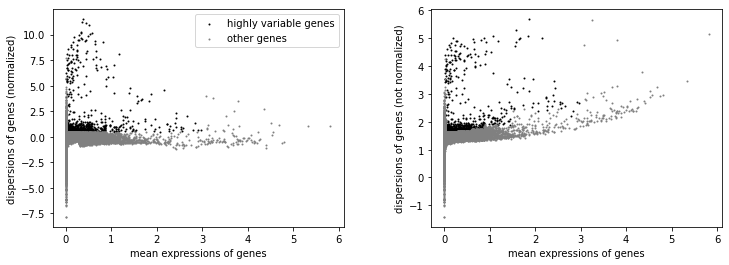

In [140]:
# find highly variable genes
sc.pp.highly_variable_genes(bmem, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bmem)

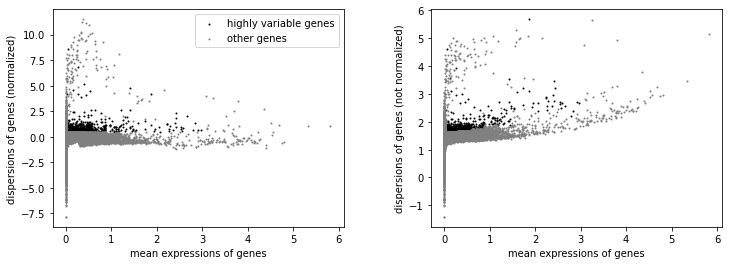

In [141]:
# remove vdj and light chain constant genes from highly variable genes, and also the viral reads
import re
for i in bmem.var.index:
    if re.search('^IG[HKL][VDJC]|VIRAL', i):
        bmem.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(bmem)

In [142]:
# transfer to .raw slot
bmem.raw = bmem

In [143]:
# Filter the rna genes to only those marked as highly-variable
bmem = bmem[:, bmem.var.highly_variable].copy()
bmem

AnnData object with n_obs × n_vars = 26512 × 1051
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartmen

In [144]:
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(bmem, ['nCount_RNA', 'pct_counts_mt'])
sc.pp.scale(bmem, max_value=10)

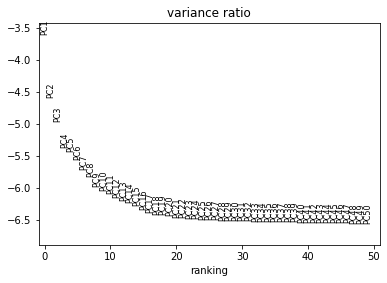

In [145]:
# Run PCA
sc.tl.pca(bmem, svd_solver='arpack')
sc.pl.pca_variance_ratio(bmem, log=True, n_pcs = 50)

In [146]:
# Correcting the PCs with harmonypy
# sc.external.pp.harmony_integrate(bmem, 'sample_id', adjusted_basis = 'X_pca', max_iter_harmony =30)
# Computing the neighborhood graph
sc.pp.neighbors(bmem, n_neighbors=10, n_pcs=20)
# Embedding the neighborhood graph
sc.tl.umap(bmem, min_dist = 0.3)

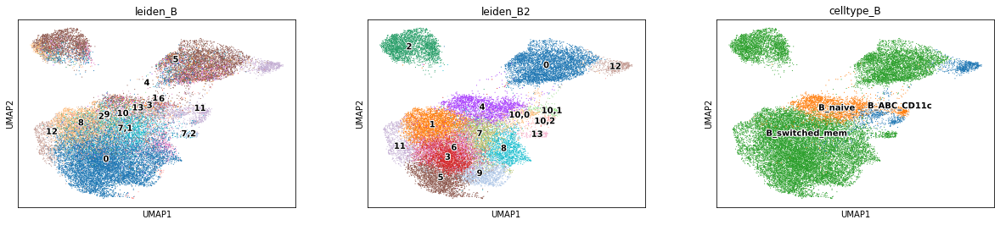

In [159]:
sc.tl.leiden(bmem, key_added = 'leiden_B2')
# sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['3']), resolution = .5)
sc.tl.leiden(bmem, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['10']), resolution = .3)
sc.pl.umap(bmem, color = ['leiden_B','leiden_B2', 'celltype_B'], legend_loc = 'on data', legend_fontoutline = 2)

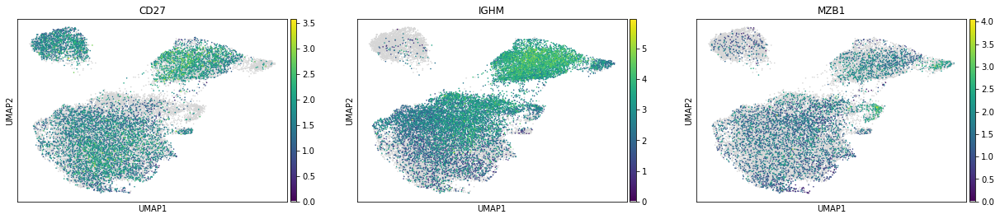

In [160]:
sc.pl.umap(bmem, color = ['CD27', 'IGHM', 'MZB1'], color_map = tools.cmp(), size = 10)

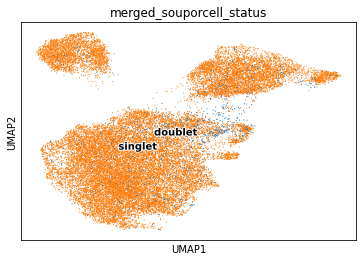

In [149]:
sc.pl.umap(bmem, color = ['merged_souporcell_status'], legend_loc = 'on data', legend_fontoutline = 2)

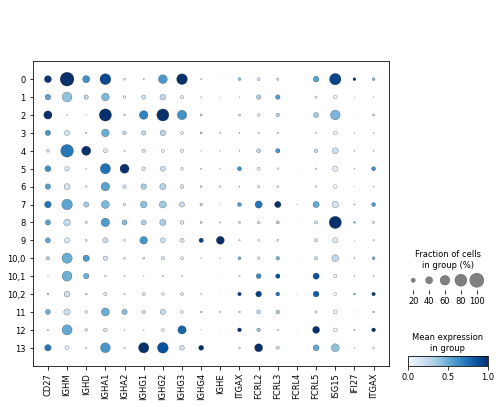

In [153]:
sc.pl.dotplot(bmem, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE','ITGAX', 'FCRL2','FCRL3','FCRL4','FCRL5', 'ISG15', 'IFI27', 'ITGAX'], groupby = 'leiden_B2', color_map = 'Blues', standard_scale = 'var')

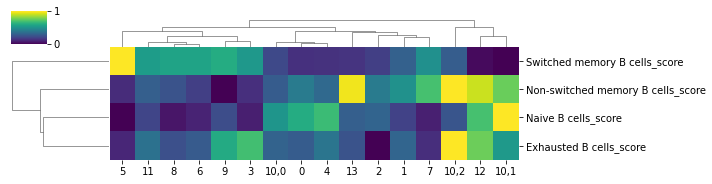

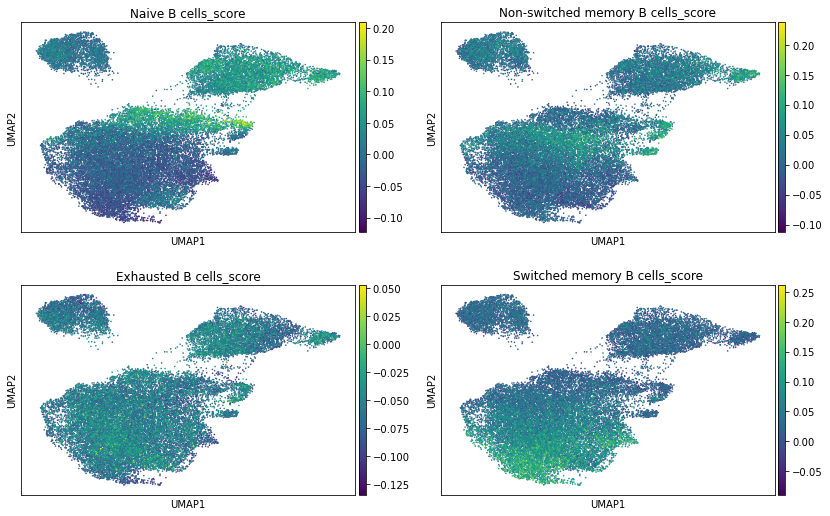

In [152]:
summarised_geneset_scores(bmem, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B2',
                          (10,2.5))

... storing 'celltype_B' as categorical


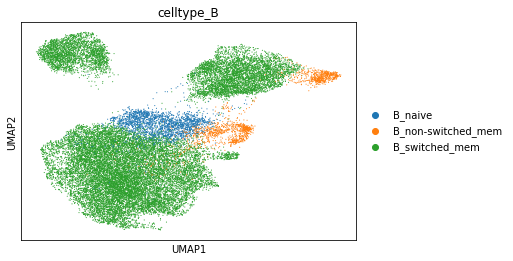

In [165]:
b_dict = {'0':'B_switched_mem',
'1':'B_switched_mem',
'2':'B_switched_mem',
'3':'B_switched_mem',
'4':'B_naive',
'5':'B_switched_mem',
'6':'B_switched_mem',
'7':'B_switched_mem',
'8':'B_switched_mem',
'9':'B_switched_mem',
'10,0':'B_non-switched_mem',
'10,1':'B_non-switched_mem',
'10,2':'B_non-switched_mem',
'11':'B_switched_mem',
'12':'B_non-switched_mem',
'13':'B_switched_mem',}
bmem.obs['celltype_B'] = [b_dict[x] for x in bmem.obs['leiden_B2']]
sc.pl.umap(bmem, color = 'celltype_B')

... storing 'celltype_B' as categorical


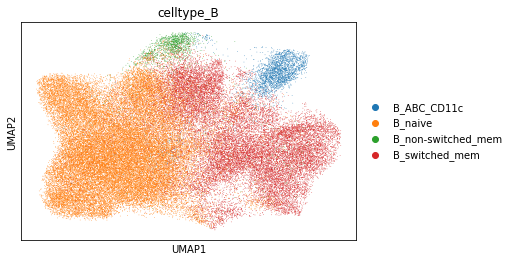

In [166]:
bcell.obs['celltype_B'] = bcell.obs['celltype_B'].astype('object')
bcell.obs['celltype_B'].update(pd.Series(bmem.obs['celltype_B']))
sc.pl.umap(bcell, color = 'celltype_B')

### repeat naive clean up

In [167]:
bnav = bcell[bcell.obs['celltype_B'].isin(['B_naive'])].raw.to_adata()

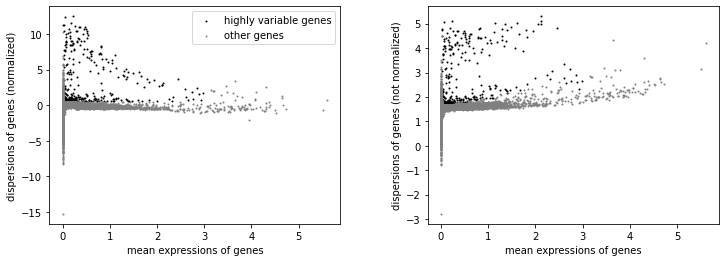

In [168]:
# find highly variable genes
sc.pp.highly_variable_genes(bnav, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bnav)

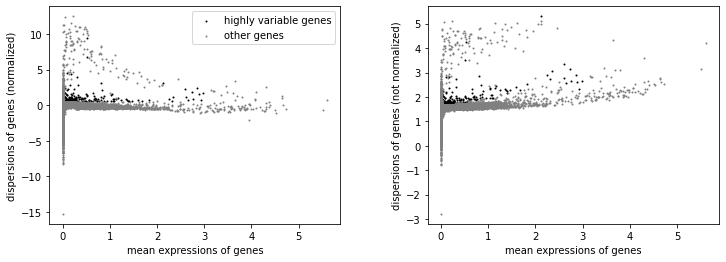

In [169]:
# remove vdj and light chain constant genes from highly variable genes, and also the viral reads
import re
for i in bnav.var.index:
    if re.search('^IG[HKL][VDJC]|VIRAL', i):
        bnav.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(bnav)

In [170]:
# transfer to .raw slot
bnav.raw = bnav

In [171]:
# Filter the rna genes to only those marked as highly-variable
bnav = bnav[:, bnav.var.highly_variable].copy()
bnav

AnnData object with n_obs × n_vars = 39769 × 314
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartment

In [172]:
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(bnav, ['nCount_RNA', 'pct_counts_mt'])
sc.pp.scale(bnav, max_value=10)

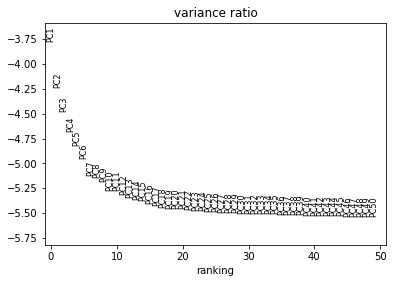

In [173]:
# Run PCA
sc.tl.pca(bnav, svd_solver='arpack')
sc.pl.pca_variance_ratio(bnav, log=True, n_pcs = 50)

In [174]:
# Correcting the PCs with harmonypy
sc.external.pp.harmony_integrate(bnav, 'sample_id', adjusted_basis = 'X_pca', max_iter_harmony =30)
# Computing the neighborhood graph
sc.pp.neighbors(bnav, n_neighbors=10, n_pcs=20)
# Embedding the neighborhood graph
sc.tl.umap(bnav, min_dist = 0.3)

2021-12-13 17:55:20,823 - harmonypy - INFO - Iteration 1 of 30
2021-12-13 17:55:53,199 - harmonypy - INFO - Iteration 2 of 30
2021-12-13 17:56:25,585 - harmonypy - INFO - Iteration 3 of 30
2021-12-13 17:56:56,800 - harmonypy - INFO - Iteration 4 of 30
2021-12-13 17:57:21,352 - harmonypy - INFO - Iteration 5 of 30
2021-12-13 17:57:44,835 - harmonypy - INFO - Iteration 6 of 30
2021-12-13 17:58:06,656 - harmonypy - INFO - Iteration 7 of 30
2021-12-13 17:58:28,941 - harmonypy - INFO - Iteration 8 of 30
2021-12-13 17:58:50,170 - harmonypy - INFO - Iteration 9 of 30
2021-12-13 17:59:12,344 - harmonypy - INFO - Iteration 10 of 30
2021-12-13 17:59:33,573 - harmonypy - INFO - Iteration 11 of 30
2021-12-13 17:59:55,963 - harmonypy - INFO - Iteration 12 of 30
2021-12-13 18:00:17,139 - harmonypy - INFO - Iteration 13 of 30
2021-12-13 18:00:39,356 - harmonypy - INFO - Iteration 14 of 30
2021-12-13 18:01:00,485 - harmonypy - INFO - Iteration 15 of 30
2021-12-13 18:01:22,963 - harmonypy - INFO - Iter

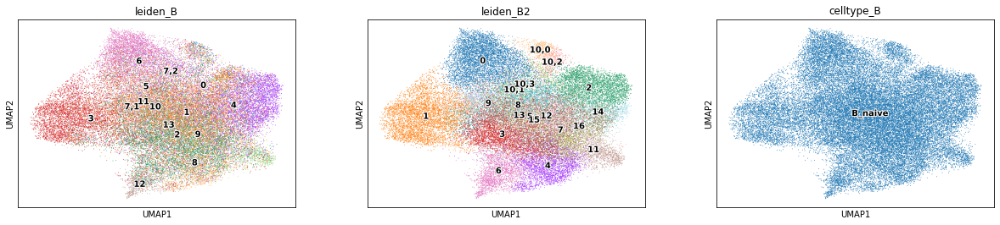

In [178]:
sc.tl.leiden(bnav, key_added = 'leiden_B2')
sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['10']), resolution = .5)
# sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['16']), resolution = .5)
sc.pl.umap(bnav, color = ['leiden_B','leiden_B2', 'celltype_B'], legend_loc = 'on data', legend_fontoutline = 2)

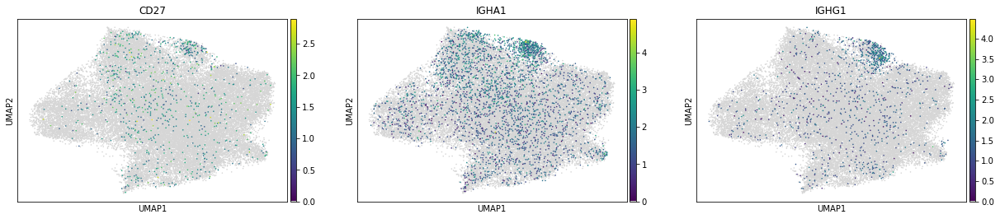

In [176]:
sc.pl.umap(bnav, color = ['CD27', 'IGHA1', 'IGHG1'], color_map = tools.cmp(), size = 10)

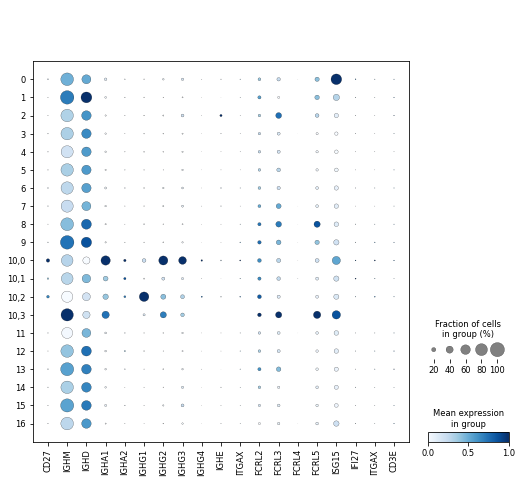

In [179]:
sc.pl.dotplot(bnav, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE','ITGAX', 'FCRL2','FCRL3','FCRL4','FCRL5', 'ISG15', 'IFI27', 'ITGAX', 'CD3E'], groupby = 'leiden_B2', color_map = 'Blues', standard_scale = 'var')

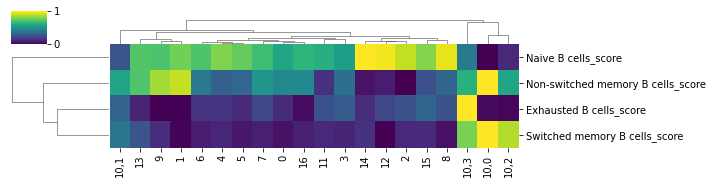

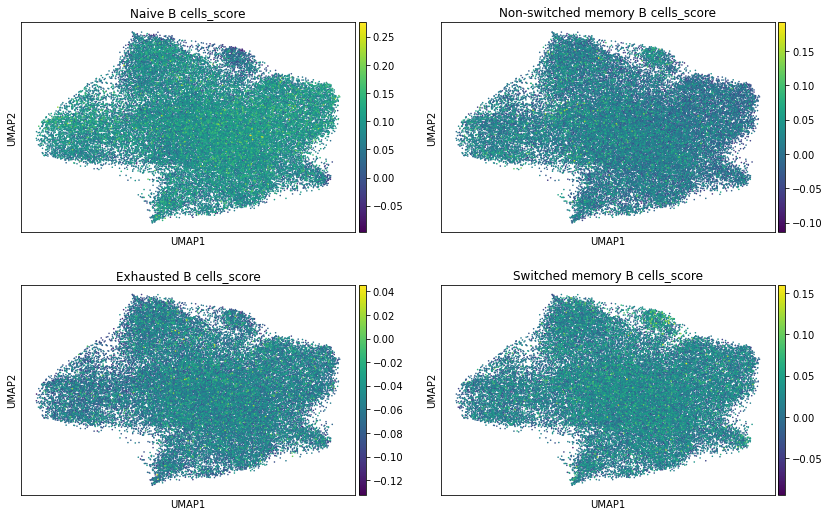

In [180]:
summarised_geneset_scores(bnav, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B2',
                          (10,2.5))

... storing 'celltype_B' as categorical


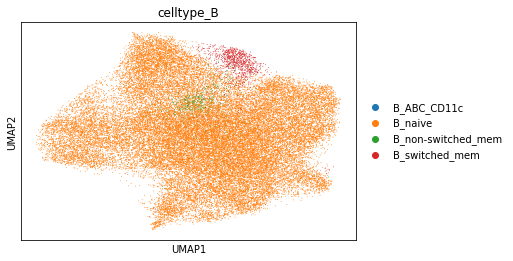

In [181]:
b_dict = {'0':'B_naive',
'1':'B_naive',
'2':'B_naive',
'3':'B_naive',
'4':'B_naive',
'5':'B_naive',
'6':'B_naive',
'7':'B_naive',
'8':'B_naive',
'9':'B_naive',
'10,0':'B_switched_mem',
'10,1':'B_non-switched_mem',
'10,2':'B_switched_mem',
'10,3':'B_ABC_CD11c',
'11':'B_naive',
'12':'B_naive',
'13':'B_naive',
'14':'B_naive',
'15':'B_naive',
'16':'B_naive',}
bnav.obs['celltype_B'] = [b_dict[x] for x in bnav.obs['leiden_B2']]
sc.pl.umap(bnav, color = 'celltype_B')

... storing 'celltype_B' as categorical


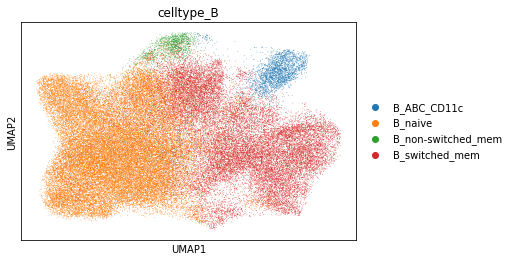

In [182]:
bcell.obs['celltype_B'] = bcell.obs['celltype_B'].astype('object')
bcell.obs['celltype_B'].update(pd.Series(bnav.obs['celltype_B']))
sc.pl.umap(bcell, color = 'celltype_B')

### check mem again

In [183]:
bmem = bcell[bcell.obs['celltype_B'].isin(['B_non-switched_mem', 'B_switched_mem', 'B_ABC_CD11c'])].raw.to_adata()

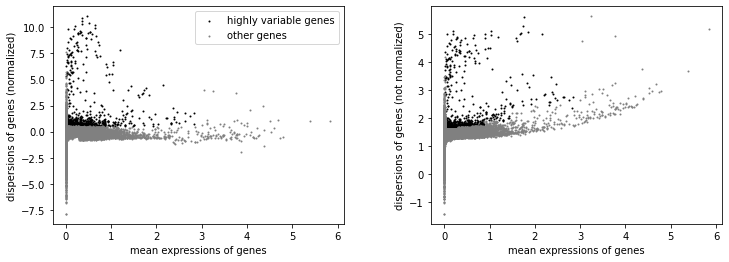

In [184]:
# find highly variable genes
sc.pp.highly_variable_genes(bmem, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bmem)

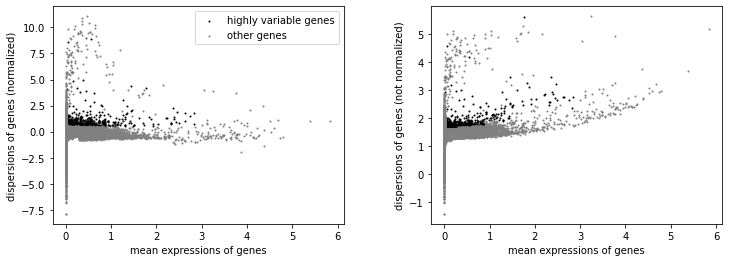

In [185]:
# remove vdj and light chain constant genes from highly variable genes, and also the viral reads
import re
for i in bmem.var.index:
    if re.search('^IG[HKL][VDJC]|VIRAL', i):
        bmem.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(bmem)

In [186]:
# transfer to .raw slot
bmem.raw = bmem

In [187]:
# Filter the rna genes to only those marked as highly-variable
bmem = bmem[:, bmem.var.highly_variable].copy()
bmem

AnnData object with n_obs × n_vars = 28673 × 1031
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartmen

In [188]:
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(bmem, ['nCount_RNA', 'pct_counts_mt'])
sc.pp.scale(bmem, max_value=10)

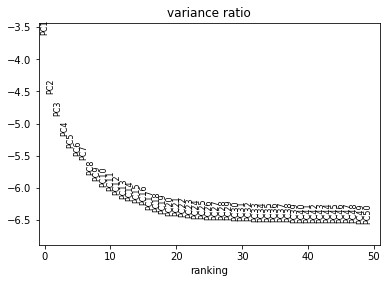

In [189]:
# Run PCA
sc.tl.pca(bmem, svd_solver='arpack')
sc.pl.pca_variance_ratio(bmem, log=True, n_pcs = 50)

In [194]:
# Correcting the PCs with harmonypy
sc.external.pp.harmony_integrate(bmem, 'sample_id', adjusted_basis = 'X_pca', max_iter_harmony =30)
# Computing the neighborhood graph
sc.pp.neighbors(bmem, n_neighbors=10, n_pcs=20)
# Embedding the neighborhood graph
sc.tl.umap(bmem, min_dist = 0.3)

2021-12-13 18:09:31,068 - harmonypy - INFO - Iteration 1 of 30
2021-12-13 18:09:55,208 - harmonypy - INFO - Iteration 2 of 30
2021-12-13 18:10:19,743 - harmonypy - INFO - Converged after 2 iterations


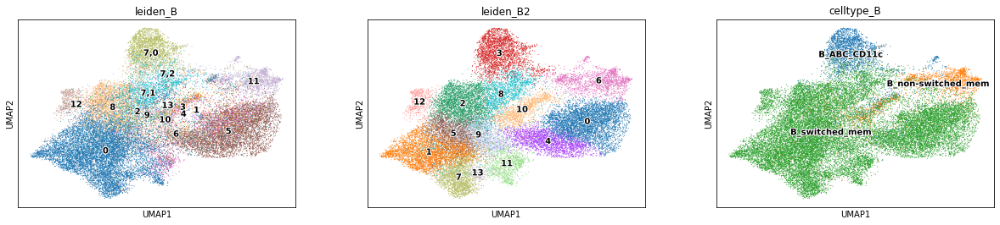

In [195]:
sc.tl.leiden(bmem, key_added = 'leiden_B2')
# sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['3']), resolution = .5)
# sc.tl.leiden(bmem, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['10']), resolution = .3)
sc.pl.umap(bmem, color = ['leiden_B','leiden_B2', 'celltype_B'], legend_loc = 'on data', legend_fontoutline = 2)

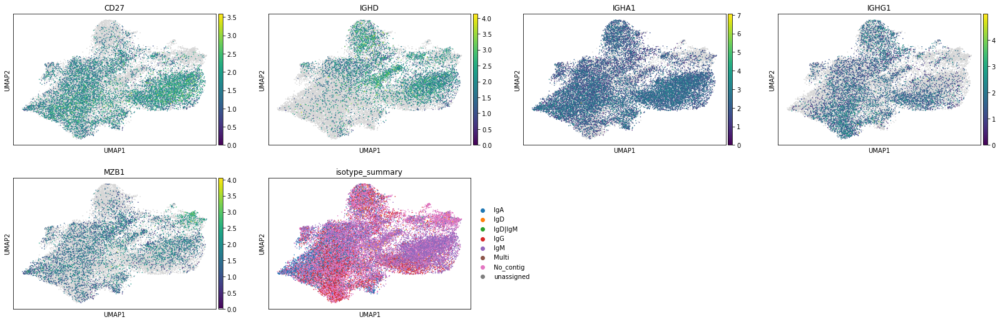

In [204]:
sc.pl.umap(bmem, color = ['CD27', 'IGHD', 'IGHA1', 'IGHG1', 'MZB1', 'isotype_summary'], color_map = tools.cmp(), size = 10)

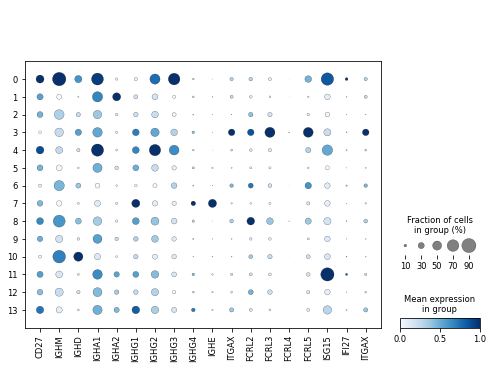

In [200]:
sc.pl.dotplot(bmem, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE','ITGAX', 'FCRL2','FCRL3','FCRL4','FCRL5', 'ISG15', 'IFI27', 'ITGAX'], groupby = 'leiden_B2', color_map = 'Blues', standard_scale = 'var')

In [209]:
def summarised_geneset_scores2(self, genesets, groupby, figsize=(3, 4), cmap = 'viridis', col_cluster = True, row_cluster = True):
    import numpy as np
    import seaborn as sns
    # calculate average enrichment score
    list1 = list(set(self.obs[groupby]))
    subset = self.obs[[groupby] + [str(s) for s in genesets]]
    output = pd.DataFrame()
    for x in list1:
        subsetX = subset[subset[groupby] == x]
        outdict = {}
        for k in [str(s) for s in genesets]:
            out = {k:np.mean(subsetX[k])}
            outdict.update(out)
        output = output.append(outdict, ignore_index=True)
    output.index = list1
    output = output[[str(s) for s in genesets]]
    g = sns.clustermap(output.transpose(), standard_scale = 1, cmap=cmap, figsize=figsize, col_cluster = col_cluster, row_cluster = row_cluster)
    sc.pl.umap(self, color = [str(s) for s in genesets], size = 10, ncols = 2)
    print(g)

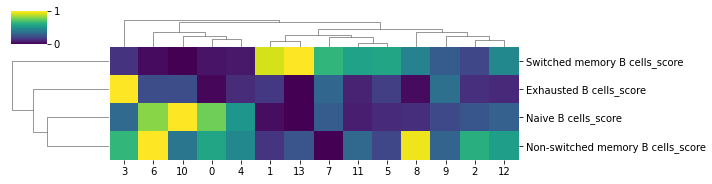

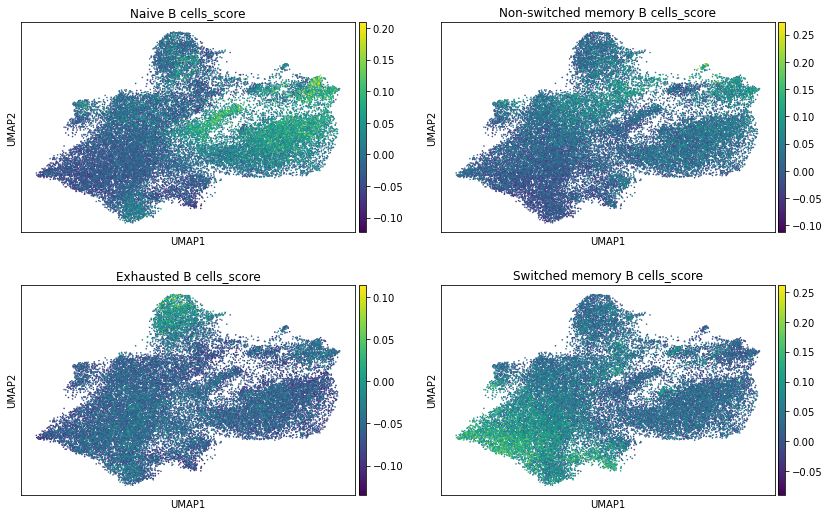

In [211]:
summarised_geneset_scores(bmem, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B2',
                          (10,2.5))

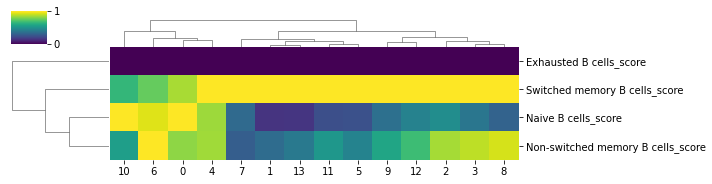

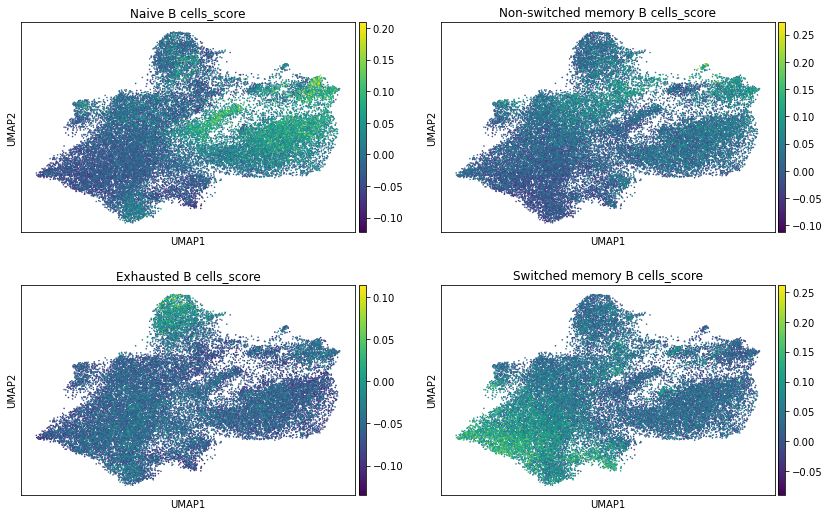

In [210]:
summarised_geneset_scores2(bmem, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B2',
                          (10,2.5))

... storing 'celltype_B' as categorical


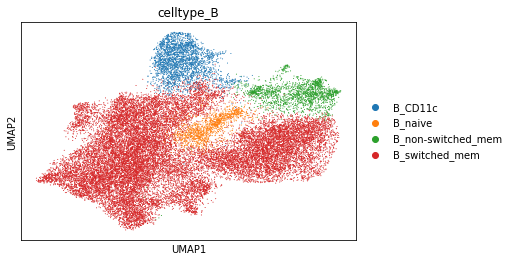

In [212]:
b_dict = {'0':'B_switched_mem',
'1':'B_switched_mem',
'2':'B_switched_mem',
'3':'B_CD11c',
'4':'B_switched_mem',
'5':'B_switched_mem',
'6':'B_non-switched_mem',
'7':'B_switched_mem',
'8':'B_switched_mem',
'9':'B_switched_mem',
'10':'B_naive',
'11':'B_switched_mem',
'12':'B_switched_mem',
'13':'B_switched_mem',}
bmem.obs['celltype_B'] = [b_dict[x] for x in bmem.obs['leiden_B2']]
sc.pl.umap(bmem, color = 'celltype_B')

... storing 'celltype_B' as categorical


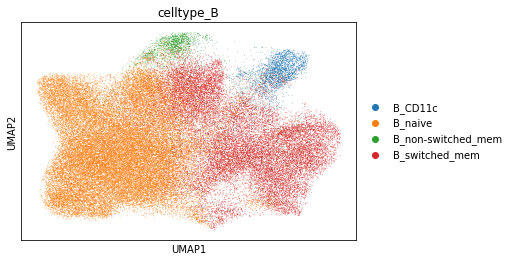

In [213]:
bcell.obs['celltype_B'] = bcell.obs['celltype_B'].astype('object')
bcell.obs['celltype_B'].update(pd.Series(bmem.obs['celltype_B']))
sc.pl.umap(bcell, color = 'celltype_B')

### repeat naive clean up

In [214]:
bnav = bcell[bcell.obs['celltype_B'].isin(['B_naive'])].raw.to_adata()

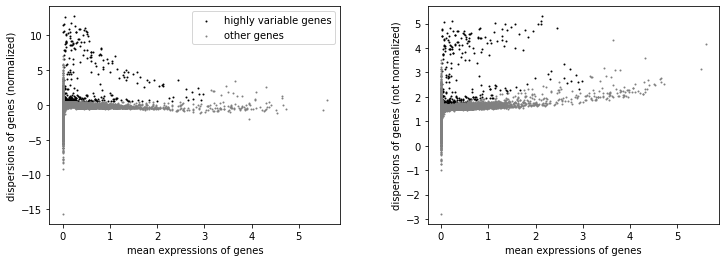

In [215]:
# find highly variable genes
sc.pp.highly_variable_genes(bnav, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bnav)

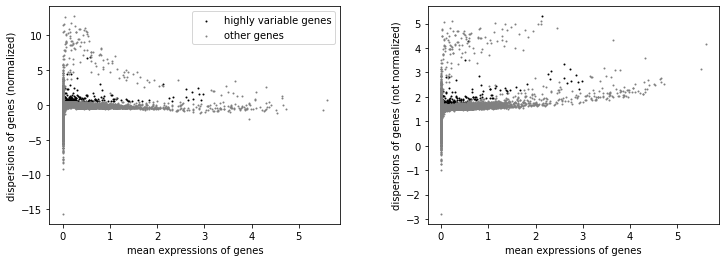

In [216]:
# remove vdj and light chain constant genes from highly variable genes, and also the viral reads
import re
for i in bnav.var.index:
    if re.search('^IG[HKL][VDJC]|VIRAL', i):
        bnav.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(bnav)

In [217]:
# transfer to .raw slot
bnav.raw = bnav

In [218]:
# Filter the rna genes to only those marked as highly-variable
bnav = bnav[:, bnav.var.highly_variable].copy()
bnav

AnnData object with n_obs × n_vars = 39488 × 306
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartment

In [219]:
# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(bnav, ['nCount_RNA', 'pct_counts_mt'])
sc.pp.scale(bnav, max_value=10)

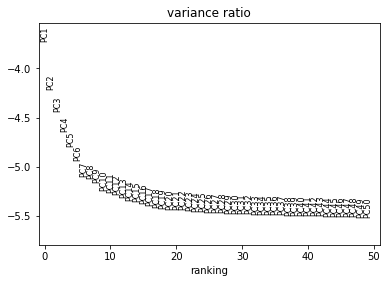

In [220]:
# Run PCA
sc.tl.pca(bnav, svd_solver='arpack')
sc.pl.pca_variance_ratio(bnav, log=True, n_pcs = 50)

In [221]:
# Correcting the PCs with harmonypy
sc.external.pp.harmony_integrate(bnav, 'sample_id', adjusted_basis = 'X_pca', max_iter_harmony =30)
# Computing the neighborhood graph
sc.pp.neighbors(bnav, n_neighbors=10, n_pcs=20)
# Embedding the neighborhood graph
sc.tl.umap(bnav, min_dist = 0.3)

2021-12-13 18:25:20,548 - harmonypy - INFO - Iteration 1 of 30
2021-12-13 18:25:54,917 - harmonypy - INFO - Iteration 2 of 30
2021-12-13 18:26:27,181 - harmonypy - INFO - Iteration 3 of 30
2021-12-13 18:26:55,800 - harmonypy - INFO - Iteration 4 of 30
2021-12-13 18:27:19,055 - harmonypy - INFO - Iteration 5 of 30
2021-12-13 18:27:40,905 - harmonypy - INFO - Iteration 6 of 30
2021-12-13 18:28:03,435 - harmonypy - INFO - Iteration 7 of 30
2021-12-13 18:28:31,340 - harmonypy - INFO - Iteration 8 of 30
2021-12-13 18:28:53,249 - harmonypy - INFO - Iteration 9 of 30
2021-12-13 18:29:15,351 - harmonypy - INFO - Iteration 10 of 30
2021-12-13 18:29:37,240 - harmonypy - INFO - Iteration 11 of 30
2021-12-13 18:29:59,047 - harmonypy - INFO - Iteration 12 of 30
2021-12-13 18:30:21,359 - harmonypy - INFO - Iteration 13 of 30
2021-12-13 18:30:43,463 - harmonypy - INFO - Iteration 14 of 30
2021-12-13 18:31:06,621 - harmonypy - INFO - Iteration 15 of 30
2021-12-13 18:31:28,493 - harmonypy - INFO - Conv

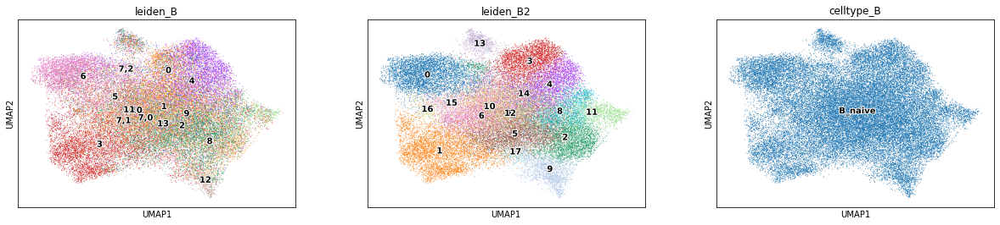

In [222]:
sc.tl.leiden(bnav, key_added = 'leiden_B2')
# sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['10']), resolution = .5)
# sc.tl.leiden(bnav, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['16']), resolution = .5)
sc.pl.umap(bnav, color = ['leiden_B','leiden_B2', 'celltype_B'], legend_loc = 'on data', legend_fontoutline = 2)

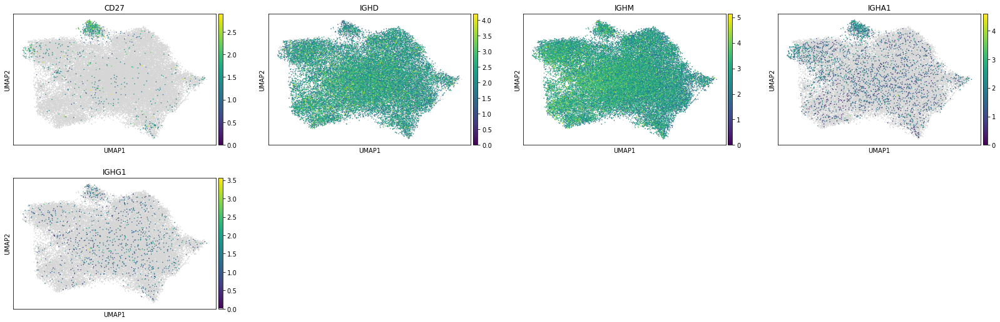

In [223]:
sc.pl.umap(bnav, color = ['CD27', 'IGHD', 'IGHM', 'IGHA1', 'IGHG1'], color_map = tools.cmp(), size = 10)

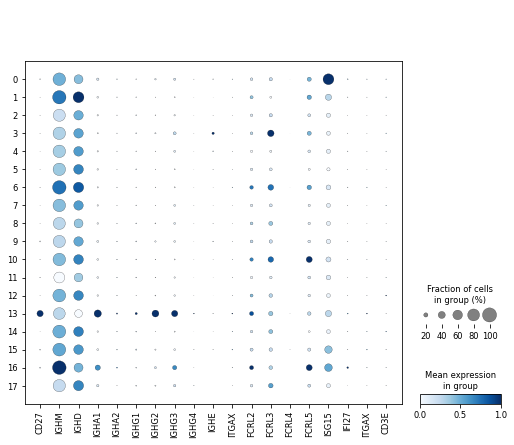

In [224]:
sc.pl.dotplot(bnav, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE','ITGAX', 'FCRL2','FCRL3','FCRL4','FCRL5', 'ISG15', 'IFI27', 'ITGAX', 'CD3E'], groupby = 'leiden_B2', color_map = 'Blues', standard_scale = 'var')

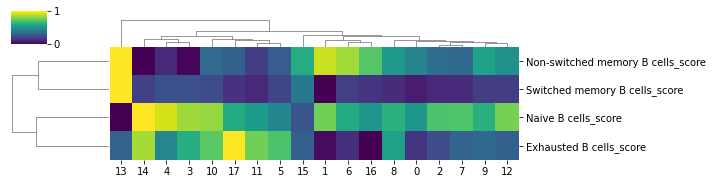

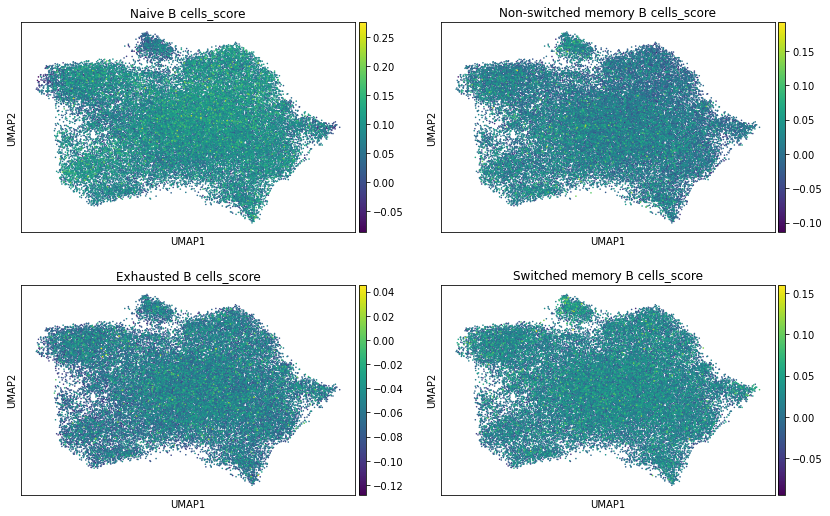

In [225]:
summarised_geneset_scores(bnav, ['Naive B cells_score', 
                                  'Non-switched memory B cells_score', 
                                  'Exhausted B cells_score', 
                                  'Switched memory B cells_score'], 
                          'leiden_B2',
                          (10,2.5))

... storing 'celltype_B' as categorical


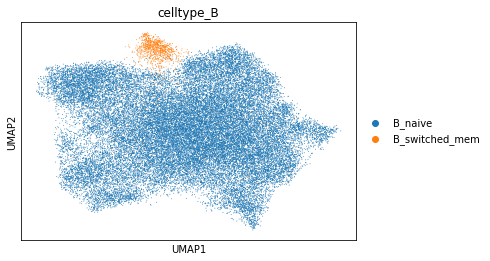

In [226]:
b_dict = {'0':'B_naive',
'1':'B_naive',
'2':'B_naive',
'3':'B_naive',
'4':'B_naive',
'5':'B_naive',
'6':'B_naive',
'7':'B_naive',
'8':'B_naive',
'9':'B_naive',
'10':'B_naive',
'11':'B_naive',
'12':'B_naive',
'13':'B_switched_mem',
'14':'B_naive',
'15':'B_naive',
'16':'B_naive',
'17':'B_naive',
}
bnav.obs['celltype_B'] = [b_dict[x] for x in bnav.obs['leiden_B2']]
sc.pl.umap(bnav, color = 'celltype_B')

... storing 'celltype_B' as categorical


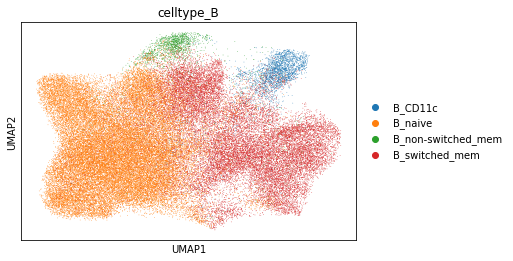

In [227]:
bcell.obs['celltype_B'] = bcell.obs['celltype_B'].astype('object')
bcell.obs['celltype_B'].update(pd.Series(bnav.obs['celltype_B']))
sc.pl.umap(bcell, color = 'celltype_B')

### propagate to all bcelldata

... storing 'celltype_B' as categorical


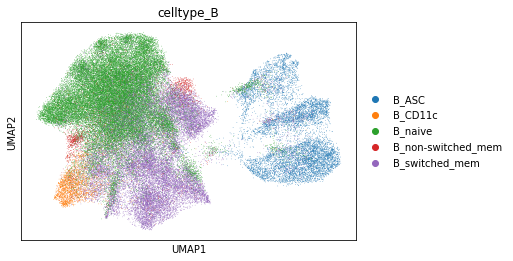

In [262]:
bdata.obs['celltype_B'] = bdata.obs['celltype_B'].astype('object')
bdata.obs['celltype_B'].update(pd.Series(bcell.obs['celltype_B']))
sc.pl.umap(bdata, color = 'celltype_B')


### analyse the ASCs

In [286]:
ascs = bdata[bdata.obs['celltype_B'].isin(['B_ASC'])].copy()

In [288]:
# Correcting the PCs with harmonypy
# sc.external.pp.harmony_integrate(ascs, 'sample_id', adjusted_basis = 'X_pca', max_iter_harmony =30)
# Computing the neighborhood graph
sc.pp.neighbors(ascs, n_neighbors=10, n_pcs=20)
# Embedding the neighborhood graph
sc.tl.umap(ascs, min_dist = 0.3)

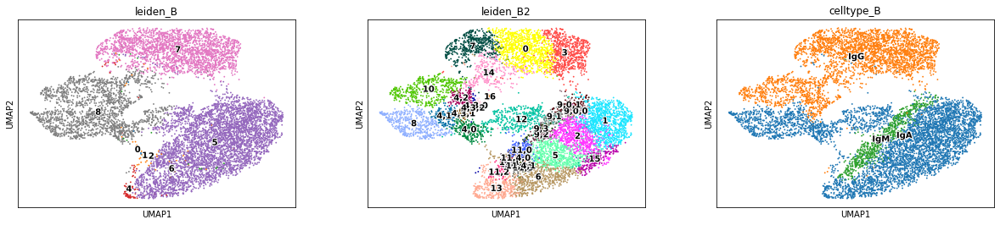

In [341]:
sc.tl.leiden(ascs, key_added = 'leiden_B2', resolution = 1)
sc.tl.leiden(ascs, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['9']), resolution = .5)
sc.tl.leiden(ascs, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['4']), resolution = .3)
sc.tl.leiden(ascs, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['4,3']), resolution = .3)
sc.tl.leiden(ascs, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['9,0']), resolution = .3)
sc.tl.leiden(ascs, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['11']), resolution = .5)
sc.tl.leiden(ascs, key_added = 'leiden_B2', restrict_to = ('leiden_B2', ['11,4']), resolution = .5)
sc.pl.umap(ascs, color = ['leiden_B','leiden_B2', 'celltype_B'], legend_loc = 'on data', legend_fontoutline = 2)

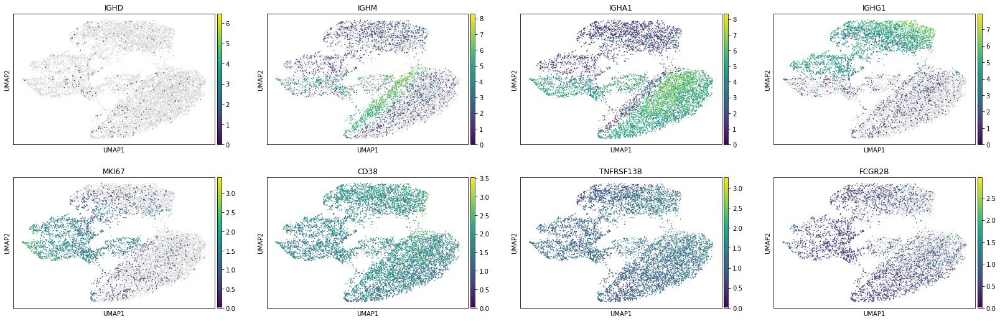

In [351]:
sc.pl.umap(ascs, color = ['IGHD', 'IGHM', 'IGHA1', 'IGHG1', 'MKI67', 'CD38', 'TNFRSF13B', 'FCGR2B'], color_map = tools.cmp(), size = 10)

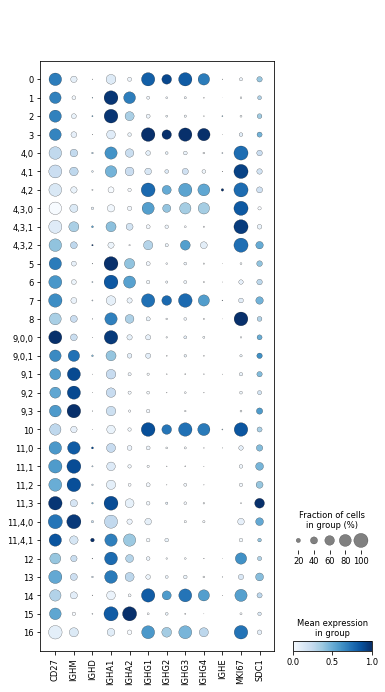

In [346]:
sc.pl.dotplot(ascs, ['CD27','IGHM','IGHD','IGHA1', 'IGHA2', 'IGHG1','IGHG2','IGHG3','IGHG4','IGHE', 'MKI67', 'SDC1'], groupby = 'leiden_B2', color_map = 'Blues', standard_scale = 'var')

... storing 'celltype_B' as categorical


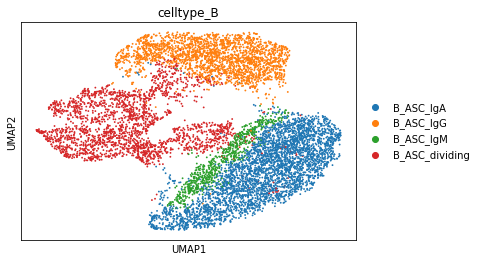

In [355]:
b_dict = {'0':'B_ASC_IgG',
'1':'B_ASC_IgA',
'2':'B_ASC_IgA',
'3':'B_ASC_IgG',
'4,0':'B_ASC_dividing',
'4,1':'B_ASC_dividing',
'4,2':'B_ASC_dividing',
'4,3,0':'B_ASC_dividing',
'4,3,1':'B_ASC_dividing',
'4,3,2':'B_ASC_dividing',
'5':'B_ASC_IgA',
'6':'B_ASC_IgA',
'7':'B_ASC_IgG',
'8':'B_ASC_dividing',
'9,0,0':'B_ASC_IgA',
'9,0,1':'B_ASC_IgM',
'9,1':'B_ASC_IgM',
'9,2':'B_ASC_IgM',
'9,3':'B_ASC_IgM',
'10':'B_ASC_dividing',
'11,0':'B_ASC_IgM',
'11,1':'B_ASC_IgM',
'11,2':'B_ASC_IgM',
'11,3':'B_ASC_IgA',
'11,4,0':'B_ASC_IgM',
'11,4,1':'B_ASC_IgA',
'12':'B_ASC_dividing',
'13':'B_ASC_IgA',
'14':'B_ASC_dividing',
'15':'B_ASC_IgA',
'16':'B_ASC_dividing',
}
ascs.obs['celltype_B'] = [b_dict[x] for x in ascs.obs['leiden_B2']]
sc.pl.umap(ascs, color = 'celltype_B')

... storing 'celltype_B' as categorical


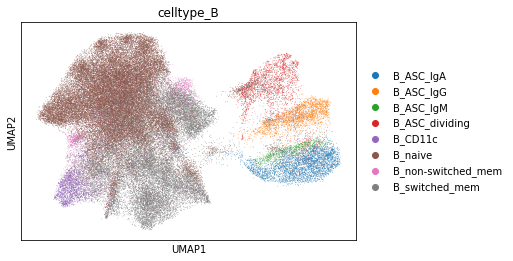

In [356]:
bdata.obs['celltype_B'] = bdata.obs['celltype_B'].astype('object')
bdata.obs['celltype_B'].update(pd.Series(ascs.obs['celltype_B']))
sc.pl.umap(bdata, color = 'celltype_B')

In [357]:
bdata

AnnData object with n_obs × n_vars = 75683 × 385
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ADT', 'nFeature_ADT', 'nCount_ADT_raw', 'nFeature_ADT_raw', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'soupxOnAdt', 'soupxOnRna', 'percentMito', 'exclude', 'centre', 'pool', 'tcrId', 'bcrId', 'celltypist_broad_predLabel', 'celltypist_broad_maxPredProb', 'haniffa_broad_predLabel', 'haniffa_broad_maxPredProb', 'yoshida_broad_predLabel', 'yoshida_broad_maxPredProb', 'celltypist_detailed_predLabel', 'celltypist_detailed_maxPredProb', 'yoshida_detailed_predLabel', 'yoshida_detailed_maxPredProb', 'seurat_clusters', 'RNA_sequencing_saturation', 'pool_factor', 'RNA_readsConfidentlyOnTranscriptome', 'RNA_readsConfidentlyOnGenome', 'RNA_readsOnGenome', 'RNA_Q30readsBarcode', 'RNA_Q30readsRead', 'RNA_Q30readsUmi', 'rna_snn_res.4', 'rna_snn_res.0.5', 'rna_snn_res.0.1', 'harmony_snn_res.4', 'yoshida_broad_predLabel_majorVote', 'harmony_snn_res.0.5', 'harmony_snn_res.0.1', 'cell_type_compartment

In [ ]:
bdata.write_h5ad('h5ad/df.fil3_gex_bcells_vdj.h5ad', compression = 'gzip')